# Rice Integration

In [1]:
rm(list=ls())
setwd("/hpc/group/pbenfeylab/CheWei/")

In [2]:
suppressMessages(library(Seurat))
suppressMessages(library(tidyverse))
suppressMessages(library(dplyr))
suppressMessages(library(cowplot))
suppressMessages(library(data.table))
suppressMessages(library(RColorBrewer))
#suppressMessages(library(OneR))

Warning message:
“package ‘ggplot2’ was built under R version 4.2.3”
Warning message:
“package ‘dplyr’ was built under R version 4.2.3”


In [3]:
sessionInfo() # New DCC env

R version 4.2.2 (2022-10-31)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: CentOS Stream 8

Matrix products: default
BLAS/LAPACK: /hpc/group/pbenfeylab/ch416/miniconda3/envs/seu4/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=C.UTF-8           LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
 [1] RColorBrewer_1.1-3 data.table_1.14.8  cowplot_1.1.1      forcats_0.5.2     
 [5] stringr_1.5.0      dplyr_1.1.1        purrr_1.0.1        readr_2.1.3       
 [9] tidyr_1.3.0        tibble_3.2.1       ggplot2_3.4.2      tidyverse_1.3.2   
[13] SeuratObject_4.1.3 Seurat_4.1.1.9001 

loaded 

In [4]:
pp.os.genes <- as.character(read.table("./CW_data/escoring/Root_sc/Rice_Protoplasting_DEgene_FC2_list.txt", header=F)$V1)
pp.os.genes <- gsub(pattern = "_", replacement = "-", x = pp.os.genes)
mt.os.genes <- as.character(read.table("./Meta_data/MSU7_mt_name.txt", header=F)$V1)
cp.os.genes <- as.character(read.table("./Meta_data/MSU7_cp_name.txt", header=F)$V1)
os2at <- read.csv("./CW_data/escoring/Root_sc/PLAZA_rice_arab_top_curated.csv", header=T)

In [5]:
use.sample <- c("sc_201","sc_202","sc_199","sc_200","sc_192","sc_193","sc_194","sc_195")
use.sample

[1] "sc_201" "sc_202" "sc_199" "sc_200" "sc_192" "sc_193" "sc_194" "sc_195"

## Integration

In [6]:
read_seu <- function(dir,sample.name) { 
  #bscs <- read.csv("../../proj_sc/cbpsc/Benfey_single_cell-Samples.csv", na.strings=c("","NA"))
  #bscs <- bscs %>% select(c('sample','name','source','genotype','transgene','treatment','age','timepoint','rep','target_cells','date','seq_run')) %>% filter(sample==sample.name)
  #bscs$date <- gsub('^([0-9]{4})([0-9]{2})([0-9]+)$', '\\1-\\2-\\3', bscs$date)
  #bscs$target_cells <- prettyNum(bscs$target_cells, big.mark = ',')
  #bscs <- t(bscs)
  
  seu <- readRDS(dir) 
  #seu@misc$sample.meta.data <- list(bscs)
  seu@assays$spliced_RNA <- NULL
  seu@assays$spliced_SCT <- NULL
  seu@assays$unspliced_RNA <- NULL
  seu@assays$unspliced_SCT <- NULL
  return(seu)
}

rc.list <- list()

for (i in 1:length(use.sample))
{
  rc.list[[i]]<-read_seu(dir = paste0("./scRNA-seq/Seurat_Objects/",use.sample[i],"_COPILOT.rds"), sample.name = use.sample[i])
}


names(rc.list) <- use.sample

for (i in 1:length(use.sample))
{
  rc.list[[i]]<- suppressWarnings(suppressMessages(UpdateSeuratObject(rc.list[[i]])))
}

In [7]:
rc.features <- SelectIntegrationFeatures(object.list = rc.list, nfeatures = 40000)
length(rc.features)

[1] 23846

In [8]:
rc.features <- rc.features[-match(pp.os.genes,rc.features)[!is.na(match(pp.os.genes,rc.features))]]
length(rc.features)

[1] 21547

In [9]:
rc.features <- rc.features[-match(mt.os.genes,rc.features)[!is.na(match(mt.os.genes,rc.features))]]
length(rc.features)

[1] 21530

In [10]:
rc.features <- rc.features[-match(cp.os.genes,rc.features)[!is.na(match(cp.os.genes,rc.features))]]
length(rc.features)

[1] 21522

In [11]:
rc.list

$sc_201
An object of class Seurat 
64008 features across 13791 samples within 2 assays 
Active assay: SCT (28283 features, 28283 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$sc_202
An object of class Seurat 
62243 features across 10373 samples within 2 assays 
Active assay: SCT (26595 features, 26595 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$sc_199
An object of class Seurat 
63993 features across 10657 samples within 2 assays 
Active assay: SCT (28268 features, 28268 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$sc_200
An object of class Seurat 
61092 features across 17087 samples within 2 assays 
Active assay: SCT (27318 features, 27318 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$sc_192
An object of class Seurat 
60944 features across 6650 samples within 2 assays 
Active assay:

In [12]:
rc.list <- PrepSCTIntegration(object.list = rc.list, anchor.features = rc.features, verbose = TRUE)

In [13]:
rc.anchors <- suppressMessages(FindIntegrationAnchors(object.list = rc.list, normalization.method = "SCT", 
    anchor.features = rc.features, verbose = TRUE, reference=1))

Warning message in CheckDuplicateCellNames(object.list = object.list):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [14]:
# Running integration
rc.integrated <- IntegrateData(anchorset = rc.anchors, normalization.method = "SCT", verbose = TRUE)

Integrating dataset 2 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 3 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 4 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 5 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 6 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 7 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 8 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Warning message:
“Adding a command log without an assay associated with it”


# Run PCA, UMAP and Clustering

In [15]:
# Run PCA
rc.integrated <- RunPCA(rc.integrated, npcs = 50, verbose = FALSE, approx = FALSE)

# Find nearest neighbors
rc.integrated <- FindNeighbors(rc.integrated, reduction = "pca",dims = 1:50)

# Clustering, notice that here we choose SLM algorithm with resoltion 5. Parameter "algorithm": 1 = original Louvain algorithm; 2 = Louvain algorithm with multilevel refinement; 3 = SLM algorithm; 4 = Leiden algorithm
rc.integrated <- FindClusters(rc.integrated, resolution = 0.5, algorithm = 3)


Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 73264
Number of edges: 2287080

Running smart local moving algorithm...
Maximum modularity in 10 random starts: 0.9283
Number of communities: 22
Elapsed time: 115 seconds


In [16]:
# Run 50D UMAP
rc.integrated <- RunUMAP(rc.integrated, reduction = "pca", dims = 1:50, n.components = 50, n.neighbors = 30, min.dist=0.3)
rc.integrated@reductions$umap_50 <- rc.integrated@reductions$umap

# Run 3D UMAP
rc.integrated <- RunUMAP(rc.integrated, reduction = "pca", dims = 1:50, n.components = 3, n.neighbors = 30, min.dist=0.3)
rc.integrated@reductions$umap_3D <- rc.integrated@reductions$umap

# Run 2D UMAP
rc.integrated <- RunUMAP(rc.integrated, reduction = "pca", dims = 1:50, n.neighbors = 30, min.dist=0.3)
rc.integrated@reductions$umap_2D <- rc.integrated@reductions$umap

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
20:10:46 UMAP embedding parameters a = 0.9922 b = 1.112

20:10:46 Read 73264 rows and found 50 numeric columns

20:10:46 Using Annoy for neighbor search, n_neighbors = 30

20:10:46 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

20:11:02 Writing NN index file to temp file /tmp/Rtmp7kX72o/file163f7816b9e36f

20:11:02 Searching Annoy index using 1 thread, search_k = 3000

20:11:55 Annoy recall = 100%

20:11:58 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbor

In [17]:
# Merge DoubletFinder results (optional) 
DF <- c()
for (i in grep("DF.classifications",colnames(rc.integrated@meta.data))){
    DF <- c(DF, rc.integrated@meta.data[,i][!is.na(rc.integrated@meta.data[,i])])
}
rc.integrated@meta.data$DF.classifications <- DF

In [18]:
saveRDS(rc.integrated, file = "./scRNA-seq/Integrated_Objects/Rice_8S_gel_soil_20231109_seu3.rds")

In [6]:
rc.integrated <- readRDS("./scRNA-seq/Integrated_Objects/Rice_8S_gel_soil_20231109_seu3.rds")

# Plotting

In [20]:
rc.integrated[["umap"]]@cell.embeddings[,1] <- rc.integrated[["umap"]]@cell.embeddings[,1]*-1
rc.integrated[["umap"]]@cell.embeddings[,2] <- rc.integrated[["umap"]]@cell.embeddings[,2]*-1
#u2 <- rc.integrated@reductions$umap@cell.embeddings[,1]
#u1 <- rc.integrated@reductions$umap@cell.embeddings[,2]
#rc.integrated@reductions$umap@cell.embeddings[,1] <- u1
#rc.integrated@reductions$umap@cell.embeddings[,2] <- u2

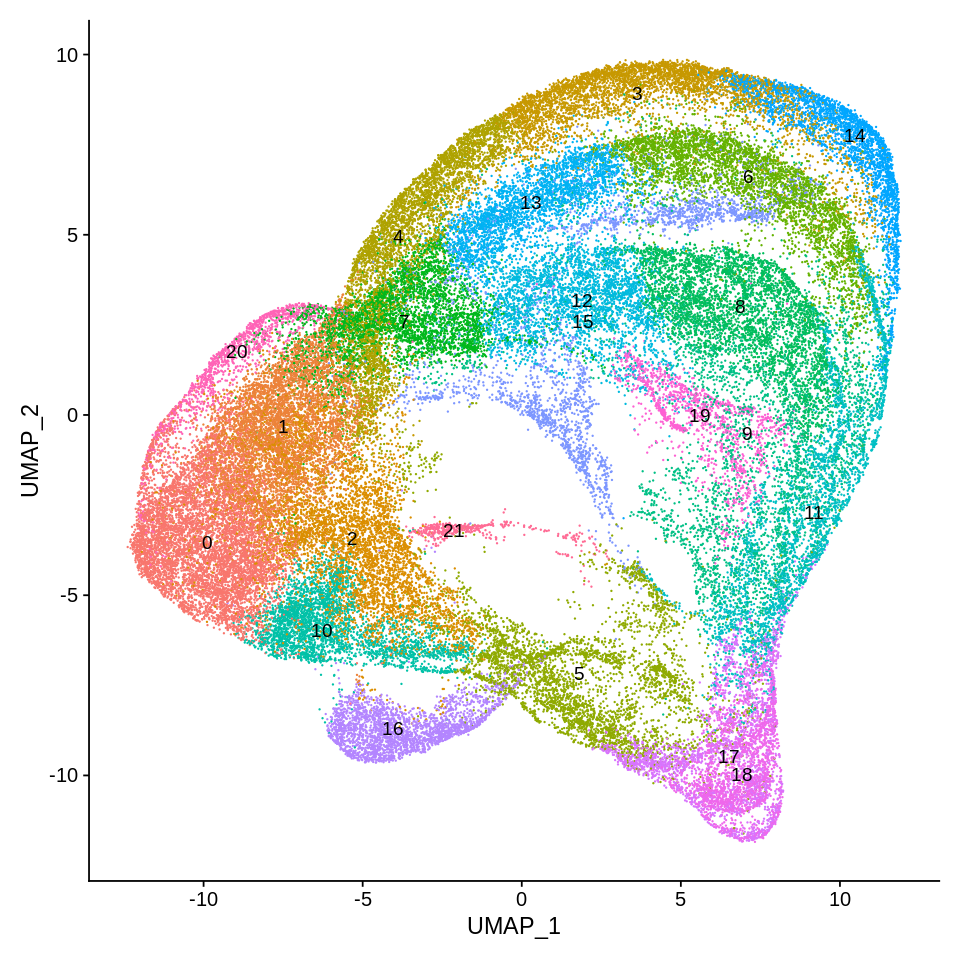

In [21]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, label=TRUE)+NoLegend()

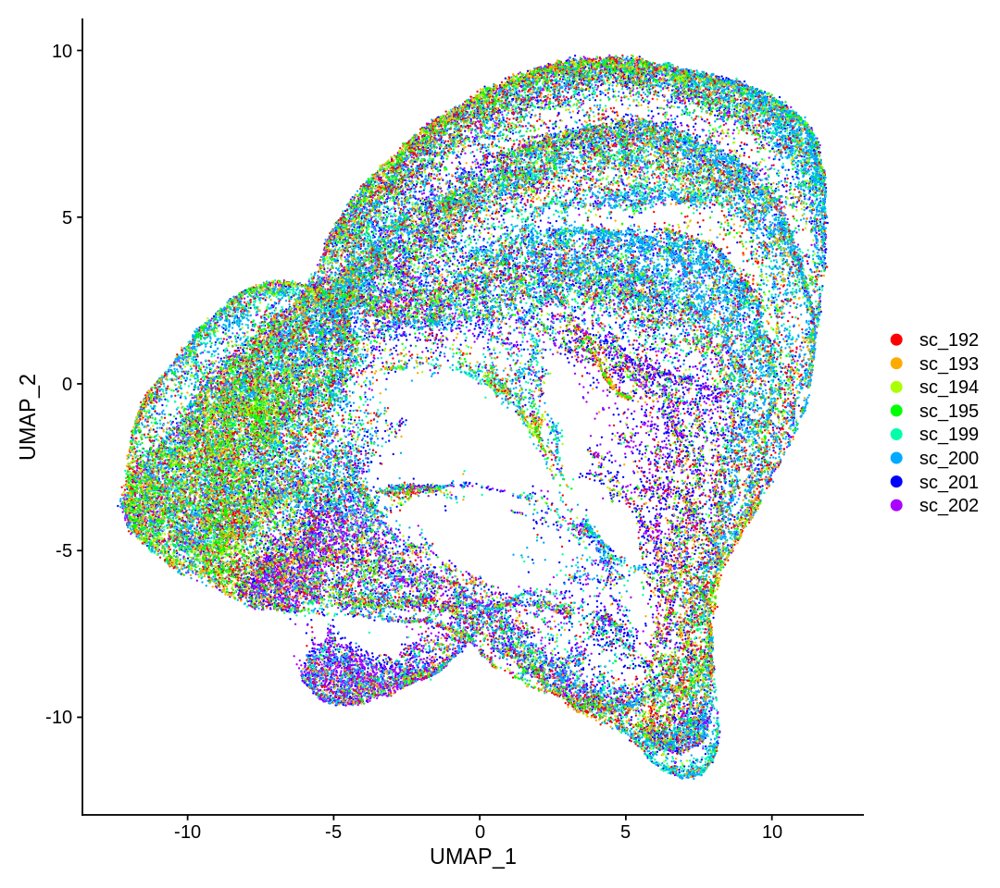

In [36]:
options(repr.plot.width=9, repr.plot.height=8)
DimPlot(rc.integrated, group.by = "orig.ident", cols= rainbow(9))

In [25]:
colnames(rc.integrated@meta.data)

[1] "orig.ident"                        "nCount_RNA"                       
 [3] "nFeature_RNA"                      "nCount_spliced_RNA"               
 [5] "nFeature_spliced_RNA"              "nCount_unspliced_RNA"             
 [7] "nFeature_unspliced_RNA"            "percent.mt"                       
 [9] "percent.cp"                        "nCount_SCT"                       
[11] "nFeature_SCT"                      "pANN_0.25_0.15_858"               
[13] "DF.classifications_0.25_0.15_858"  "nCount_spliced_SCT"               
[15] "nFeature_spliced_SCT"              "nCount_unspliced_SCT"             
[17] "nFeature_unspliced_SCT"            "SCT_snn_res.0.5"                  
[19] "seurat_clusters"                   "predicted.id"                     
[21] "prediction.score.Endodermis"       "prediction.score.Sclerenchyma"    
[23] "prediction.score.Exodermis"        "prediction.score.Trichoblast"     
[25] "prediction.score.Stem.Cell.Niche"  "prediction.score.Pericycle"       
[27] "prediction.score.Cortex"           "prediction.score.Atrichoblast"    
[29] "prediction.score.Metaxylem"        "prediction.score.Protoxylem"      
[31] "prediction.score.Phloem"           "prediction.score.Root.Cap"        
[33] "prediction.score.max"              "celltype.anno"                    
[35] "prediction.score.Elongation"       "prediction.score.Maturation"      
[37] "prediction.score.Meristem"         "time.anno"                        
[39] "celltype.anno.gel12S"              "time.anno.gel12S"                 
[41] "timezone.ID.P"                     "timezone.cor.P"                   
[43] "timezone.pvalue.P"                 "SCT_snn_res.10"                   
[45] "score.crude.anno"                  "SCT_snn_res.100"                  
[47] "score.anno"                        "consensus.anno"                   
[49] "pANN_0.25_0.15_471"                "DF.classifications_0.25_0.15_471" 
[51] "pANN_0.25_0.15_498"                "DF.classifications_0.25_0.15_498" 
[53] "pANN_0.25_0.15_1362"               "DF.classifications_0.25_0.15_1362"
[55] "SCT_snn_res.3"                     "SCT_snn_res.5"                    
[57] "pANN_0.25_0.15_371"                "DF.classifications_0.25_0.15_371" 
[59] "pANN_0.25_0.15_232"                "DF.classifications_0.25_0.15_232" 
[61] "pANN_0.25_0.15_174"                "DF.classifications_0.25_0.15_174" 
[63] "pANN_0.25_0.15_190"                "DF.classifications_0.25_0.15_190" 
[65] "integrated_snn_res.0.5"            "DF.classifications"

In [27]:
wanted_cols <- c("orig.ident", "nCount_RNA", "nFeature_RNA","nCount_spliced_RNA","nFeature_spliced_RNA", "nCount_unspliced_RNA",
                "nFeature_unspliced_RNA","percent.mt","percent.cp","nCount_SCT","nFeature_SCT","nCount_spliced_SCT","nFeature_spliced_SCT",
                "nCount_unspliced_SCT","nFeature_unspliced_SCT","seurat_clusters")
rc.integrated@meta.data <- rc.integrated@meta.data[,wanted_cols]

In [28]:
colnames(rc.integrated@meta.data)

[1] "orig.ident"             "nCount_RNA"             "nFeature_RNA"          
 [4] "nCount_spliced_RNA"     "nFeature_spliced_RNA"   "nCount_unspliced_RNA"  
 [7] "nFeature_unspliced_RNA" "percent.mt"             "percent.cp"            
[10] "nCount_SCT"             "nFeature_SCT"           "nCount_spliced_SCT"    
[13] "nFeature_spliced_SCT"   "nCount_unspliced_SCT"   "nFeature_unspliced_SCT"
[16] "seurat_clusters"

In [34]:
rc.integrated$condition <- rc.integrated$orig.ident
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_192")]="gel"
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_193")]="gel"
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_194")]="gel"
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_195")]="gel"
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_199")]="non-compact soil"
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_200")]="non-compact soil"
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_201")]="compact soil"
rc.integrated$condition[which(rc.integrated$orig.ident=="sc_202")]="compact soil"
rc.integrated$condition <- factor(rc.integrated$condition, levels = c('gel','non-compact soil', 'compact soil'))
rc.integrated$gel_soil <- rc.integrated$orig.ident
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_192")]="gel"
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_193")]="gel"
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_194")]="gel"
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_195")]="gel"
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_199")]="soil"
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_200")]="soil"
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_201")]="soil"
rc.integrated$gel_soil[which(rc.integrated$orig.ident=="sc_202")]="soil"

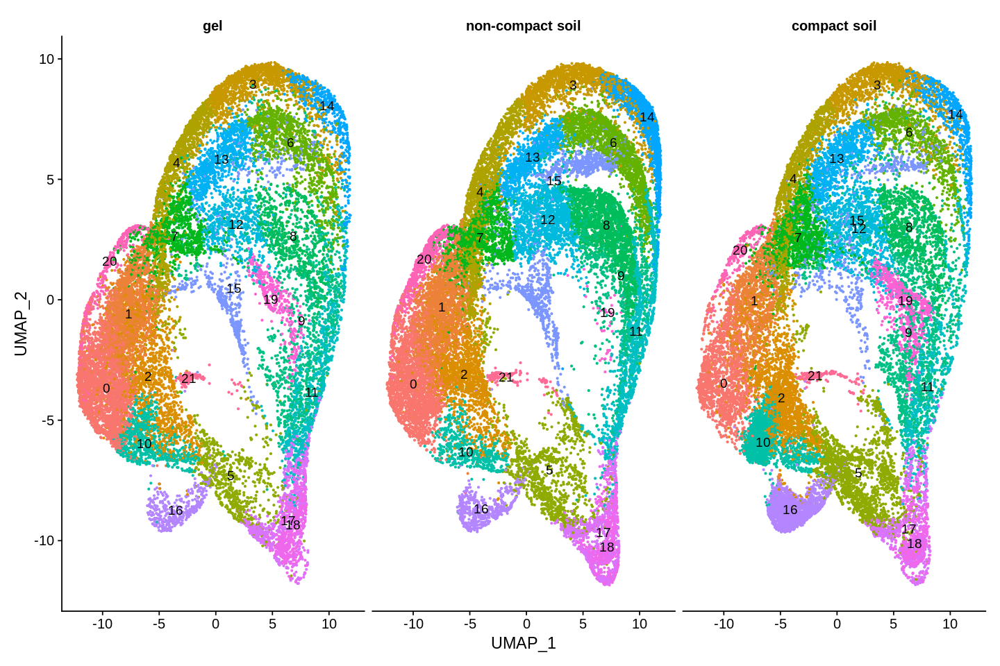

In [37]:
options(repr.plot.width=12, repr.plot.height=8)
DimPlot(rc.integrated, label=TRUE, split.by="condition", pt.size=0.5)+NoLegend()

## Time zone anno

In [47]:
load("./Meta_data/Root_bulk_rice_curated.RD")

In [48]:
nrow(time_MSU)

[1] 1500

In [49]:
head(time_MSU)

,Meristem,Elongation,Maturation1,Maturation2
,<dbl>,<dbl>,<dbl>,<dbl>
LOC-Os01g01010,3.8171504,3.6033069,3.9269744,4.070318
LOC-Os01g01019,-0.1014923,0.5701927,0.8801323,0.895213
LOC-Os01g01030,3.8802457,3.0066841,3.3899125,3.328385
LOC-Os01g01040,5.3393929,7.0232611,7.1812127,6.560164
LOC-Os01g01050,2.6873846,2.4492419,4.2526756,4.067421
LOC-Os01g01060,9.3628724,7.8553273,6.4893337,5.912760


In [50]:
# Extract matrix of integrated-batch-corrected expression value 
rc <- as.matrix(rc.integrated@assays$integrated@data)

In [51]:
# Merge the reference expression profile with the normalized expression matrix of our sample  

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}

time <- Reduce(merge.rownames, list(time_MSU,rc))

In [52]:
## Number of genes
nrow(time)

[1] 1167

In [53]:
head(time)

,Meristem,Elongation,Maturation1,Maturation2,AAACCCAAGCGACATG_1,AAACCCACAGGTACGA_1,AAACCCACAGTCAACT_1,AAACCCACATTAAAGG_1,AAACCCATCAATCTCT_1,AAACCCATCCATGCAA_1,⋯,TTTGGTTCAAATCAGA_8,TTTGGTTGTCGAATTC_8,TTTGGTTTCGTGGGTC_8,TTTGTTGAGAGATTCA_8,TTTGTTGAGCCGTAAG_8,TTTGTTGAGGACAACC_8,TTTGTTGCACCCAATA_8,TTTGTTGGTCGATTAC_8,TTTGTTGGTGTGATGG_8,TTTGTTGTCGAACTCA_8
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LOC-Os01g01010,3.8171504,3.6033069,3.9269744,4.070318,-0.1121294,-0.09161213,-0.13291146,-0.09260604,-0.07717256,-0.10103735,⋯,-0.07348306,-0.10499013,-0.09311028,5.9503889,-0.07614352,-0.02320018,-0.09705105,-0.08819133,-0.07838252,-0.05547963
LOC-Os01g01019,-0.1014923,0.5701927,0.8801323,0.895213,-0.1061705,-0.08614277,-0.12647838,-0.08711262,-0.07205563,-0.09534105,⋯,0.88498298,-0.07938431,-0.40415330,-0.1268104,-0.33292475,-0.35344117,0.01738109,-0.06950368,-0.07274609,-0.05110067
LOC-Os01g01030,3.8802457,3.0066841,3.3899125,3.328385,-0.1345602,-0.10993673,-0.15930972,-0.11113251,-0.09254402,-0.12126574,⋯,0.33687541,-0.10632430,-0.10239847,-0.2431778,-0.09454394,-0.10421800,0.08433412,-0.08471850,-0.09649510,-0.06539313
LOC-Os01g01040,5.3393929,7.0232611,7.1812127,6.560164,0.4137070,-0.45337487,0.04230228,0.90304715,-0.39183318,0.67060513,⋯,0.78173064,-0.37637036,0.01184159,0.6872123,2.42146568,-0.43384034,-0.09470646,-0.96208146,-0.27388752,1.84782077
LOC-Os01g01050,2.6873846,2.4492419,4.2526756,4.067421,-0.2279133,-0.18831339,-0.26639961,-0.19025944,-0.15981919,-0.20666479,⋯,-0.14948826,-0.29482056,-0.13770686,-0.3292916,-0.25498112,1.98795903,0.25170618,-0.33107692,-0.62358403,-0.15482476
LOC-Os01g01060,9.3628724,7.8553273,6.4893337,5.912760,-0.6260329,-0.55757796,-0.68547470,-0.56111352,-0.50384591,-0.59021846,⋯,-0.41794850,-0.73868654,-0.47794539,1.0075510,-0.60314602,-0.58269732,-0.28503900,1.52643201,-0.73674900,-0.50432170


In [54]:
# Prepare customized label name (optional)
time_label=c("Meristem","Elongation","Maturation1","Maturation2")

In [55]:
# Calculating the correlation coefficient of each cell to each reference expression profile and annotate the cell as the label that it has the highest correlation coefficient with.  
time_stat <- suppressWarnings(sapply(5:ncol(time), function(i) sapply(1:4, function(j) cor.test(time[,i],time[,j],method = "pearson")[c(3,4)])))
time_cor <- time_stat[seq(2,nrow(time_stat),2),]
time_pvalue <- time_stat[seq(1,nrow(time_stat)-1,2),]
time_max <- sapply(1:(ncol(time)-4), function(i) max(as.numeric(time_cor[,i])))
time_ident <- sapply(1:(ncol(time)-4), function(i) time_label[which(as.numeric(time_cor[,i])==max(as.numeric(time_cor[,i])))])
time_maxp <- sapply(1:(ncol(time)-4), function(i) as.numeric(time_pvalue[,i])[which(as.numeric(time_cor[,i])==max(as.numeric(time_cor[,i])))])
names(time_max) <- time_ident

In [56]:
# Store the annotation, correlation coefficient and the p-value in Seurat object
rc.integrated@meta.data$timezone.ID.P <- as.character(time_ident)
rc.integrated@meta.data$timezone.cor.P <- time_max
rc.integrated@meta.data$timezone.pvalue.P <- time_maxp

# In case there is cell with insufficient information for annotation, label them as "unknown"
rc.integrated@meta.data$timezone.ID.P[which(rc.integrated@meta.data$timezone.ID.P=='character(0)')]="unknown"

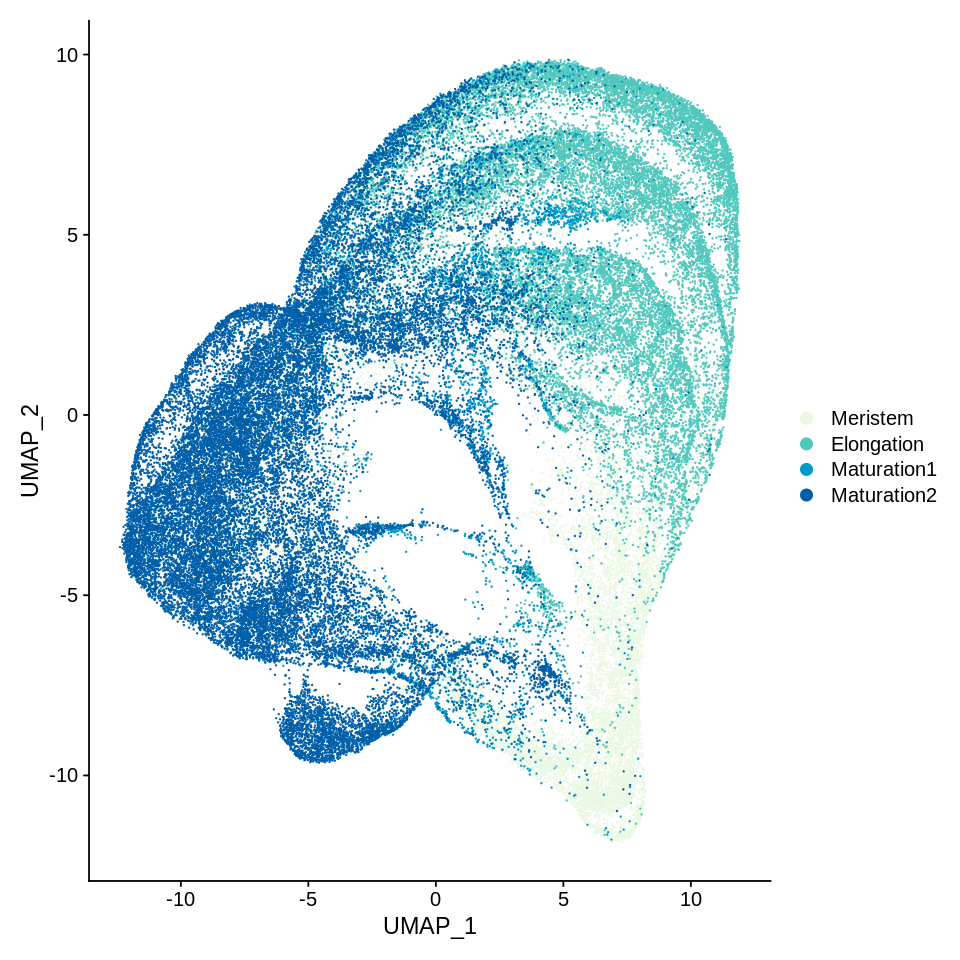

In [57]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "timezone.ID.P", order = c("Maturation2","Maturation1","Elongation","Meristem"),cols = c("#ebf8e3", "#51c8bd", "#009ac8", "#005fa8"))

## Sample correlation

In [58]:
table(rc.integrated$orig.ident)


sc_192 sc_193 sc_194 sc_195 sc_199 sc_200 sc_201 sc_202 
  6650   5296   4608   4802  10657  17087  13791  10373 

In [59]:
m1 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_192")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_192")])
m2 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_193")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_193")])
m3 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_194")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_194")])
m4 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_195")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_195")])
m5 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_199")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_199")])
m6 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_200")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_200")])
m7 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_201")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_201")])
m8 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_202")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_202")])

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.6 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.2 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 2.5 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 4.0 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 3.2 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 2.4 GiB”


In [60]:
dat <- data.frame(sc_192=m1, sc_193=m2, sc_194=m3, sc_195=m4, sc_199=m5, sc_200=m6, sc_201=m7, sc_202=m8)

Warning message in brewer.pal(11, "YlOrRd"):
“n too large, allowed maximum for palette YlOrRd is 9
Returning the palette you asked for with that many colors
”


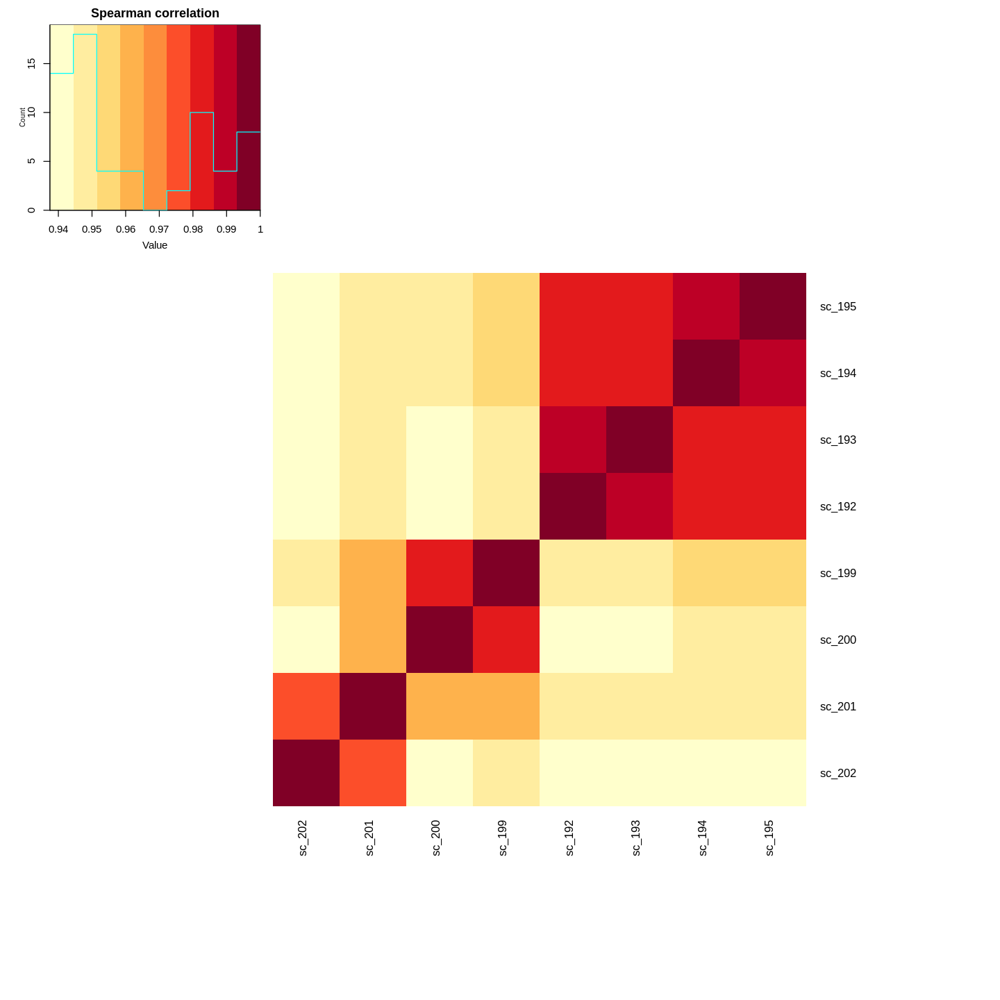

In [61]:
options(repr.plot.width=12, repr.plot.height=12)
##The agglomeration method to be used. This should be (an unambiguous abbreviation of) one of "ward.D", "ward.D2", "single", "complete", "average" (= UPGMA), "mcquitty" (= WPGMA), "median" (= WPGMC) or "centroid" (= UPGMC).
##The distance measure to be used. This must be one of "euclidean", "maximum", "manhattan", "canberra", "binary" or "minkowski". Any unambiguous substring can be given.
gplots::heatmap.2(cor(dat,method = "spearman"),col = brewer.pal(11,"YlOrRd"), 
          hclustfun = function(x) hclust(x, method = "ward.D2"), dendrogram="none",
          distfun = function(x) dist(x, method = "euclidean"), key.title = "Spearman correlation", trace = "none",cexCol = 1, cexRow = 1, margin=c(14,14),Colv=TRUE, Rowv = TRUE)

## Cell type anno with known marker z-score

In [74]:
zscore <- function(x){(x-mean(x))/sd(x)}
#known.good.markers <- read.csv("./Meta_data/Potential_good_markers_for_annotation_20221129_Final.csv")
known.good.markers <- read.csv("./Meta_data/Rice_Final_Marker_List.csv")
known.good.markers$Gene.ID <- gsub("^LOC_","LOC-",known.good.markers$Gene.ID)

In [75]:
known.good.markers

Cell.type,Gene.ID,Whether.used.for.Atlas.annotation
<chr>,<chr>,<chr>
Epidermis,LOC-Os03g19990,No
Atrichoblast,LOC-Os01g50820,Yes
Atrichoblast,LOC-Os01g64840,Yes
Atrichoblast,LOC-Os01g14650,Yes
Trichoblast,LOC-Os12g05380,No
Trichoblast,LOC-Os05g38770,Yes
Trichoblast,LOC-Os10g03400,Yes
Trichoblast,LOC-Os04g45290,Yes
Trichoblast,LOC-Os06g48050,Yes


In [76]:
#known.good.markers$Cell.type <- gsub("Epidermis, Root cap", "Root Cap", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Celltype <- gsub("Epidermis", "Atrichoblast", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Cell.type <- gsub("Early Metaxylem", "Xylem", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Celltype <- gsub("Late Metaxylem", "Xylem", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Cell.type <- gsub("Meristem", "Stem cell niche", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Cell.type <- gsub("QC", "Stem cell niche", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Cell.type <- gsub("Root Cap junction", "Root Cap", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);

In [77]:
## markers not shared
which(is.na(match(known.good.markers$Gene.ID,rownames(rc.integrated@assays$integrated@data))))

[1]  6 11 12 15 33 36 52

In [78]:
known.good.markers <- known.good.markers[-which(is.na(match(known.good.markers$Gene.ID,rownames(rc.integrated@assays$integrated@data)))),]

In [79]:
 as.character(unique(known.good.markers$Cell.type))

[1] "Epidermis"       "Atrichoblast"    "Trichoblast"     "Exodermis"      
 [5] "Sclerenchyma"    "Cortex"          "Endodermis"      "Pericycle"      
 [9] "Phloem"          "Xylem"           "Metaxylem"       "Early Metaxylem"
[13] "Root Cap"        "Stem cell niche"

In [80]:
#known.good.markers <- known.good.markers[-which(known.good.markers$Cell.type == "Xylem"),]
known.good.markers <- known.good.markers[-which(known.good.markers$Cell.type == "Root Cap"),]
#known.good.markers <- known.good.markers[-which(known.good.markers$Cell.type == "Stem cell niche"),]

In [81]:
## Remove un specifc Atrichoblast marker
known.good.markers <- known.good.markers[-which(known.good.markers$Gene.ID == "LOC-Os01g14650"),]
known.good.markers <- known.good.markers[-which(known.good.markers$Gene.ID == "LOC-Os02g56130"),]

In [82]:
known.good.markers

,Cell.type,Gene.ID,Whether.used.for.Atlas.annotation
,<chr>,<chr>,<chr>
1,Epidermis,LOC-Os03g19990,No
2,Atrichoblast,LOC-Os01g50820,Yes
3,Atrichoblast,LOC-Os01g64840,Yes
5,Trichoblast,LOC-Os12g05380,No
7,Trichoblast,LOC-Os10g03400,Yes
8,Trichoblast,LOC-Os04g45290,Yes
9,Trichoblast,LOC-Os06g48050,Yes
10,Trichoblast,LOC-Os01g03530,Yes
13,Trichoblast,LOC-Os03g19330,No


In [16]:
# Crude
# Find clusters, here we choose Leiden clustering algorithm with resolution 2. Parameter "algorithm": 1 = original Louvain algorithm; 2 = Louvain algorithm with multilevel refinement; 3 = SLM algorithm; 4 = Leiden algorithm
DefaultAssay(rc.integrated) <- "integrated"
suppressMessages(suppressWarnings(
  rc.integrated <- FindClusters(rc.integrated, resolution = 2, algorithm = 3)
))

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 73264
Number of edges: 2287080

Running smart local moving algorithm...
Maximum modularity in 10 random starts: 0.8838
Number of communities: 56
Elapsed time: 71 seconds


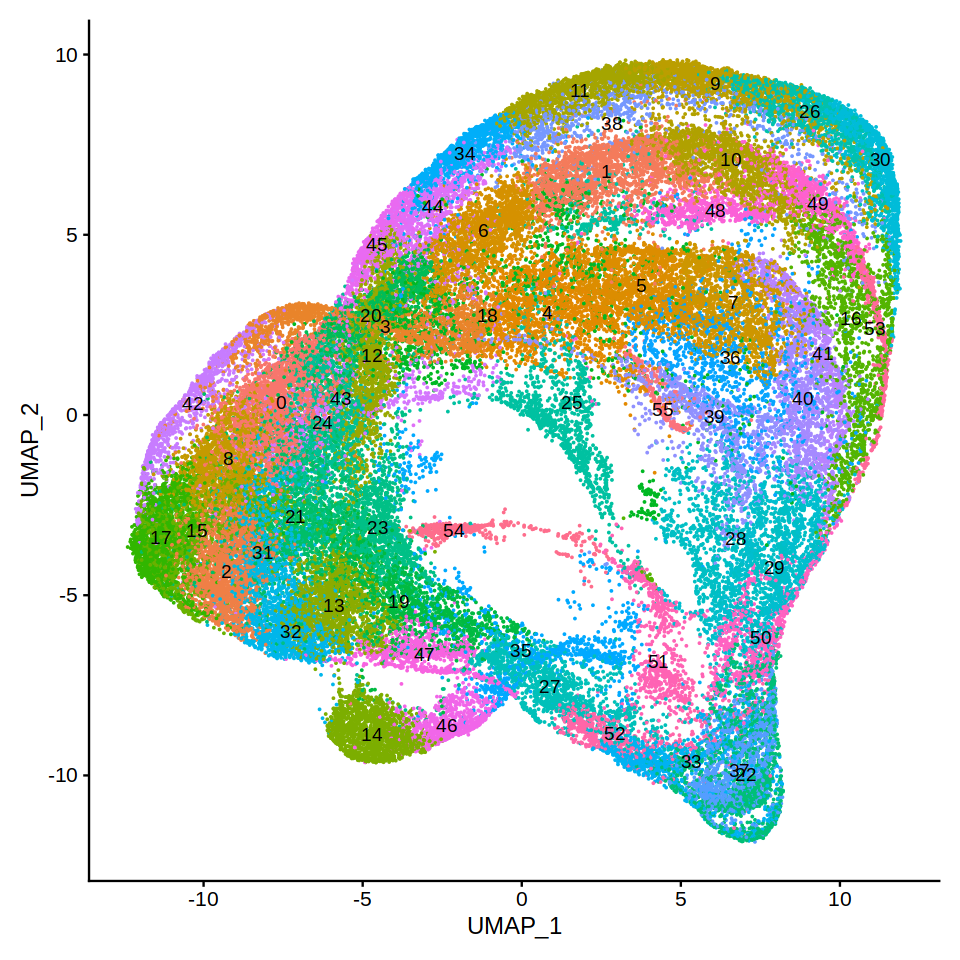

In [17]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", label=TRUE)+NoLegend()

In [83]:
msc <- c()
for (i in as.character(unique(known.good.markers$Cell.type))){
    if (length(known.good.markers[which(known.good.markers$Cell.type== i),]$Gene.ID)>1){
    msc <- cbind(msc, as.numeric(apply(apply(rc.integrated@assays$integrated@data[known.good.markers[which(known.good.markers$Cell.type== i),]$Gene.ID,], 1, zscore), 1, mean)))       
    } else {
    msc <- cbind(msc, as.numeric(zscore(rc.integrated@assays$integrated@data[known.good.markers[which(known.good.markers$Cell.type== i),]$Gene.ID,])))      
    }

}
colnames(msc) <- as.character(unique(known.good.markers$Cell.type))
rownames(msc) <- colnames(rc.integrated)

In [84]:
head(msc)

,Epidermis,Atrichoblast,Trichoblast,Exodermis,Sclerenchyma,Cortex,Endodermis,Pericycle,Phloem,Xylem,Metaxylem,Early Metaxylem,Stem cell niche
AAACCCAAGCGACATG_1,-0.1841390,-0.14087487,-0.1845605,-0.2110170,-0.1459970,0.2574869,-0.1736708,-0.1972163,-0.2008819,-0.2113970,-0.2121745,-0.06569940,-0.1607782
AAACCCACAGGTACGA_1,-0.1458847,-0.11184794,-0.1496613,-0.1741289,-0.1267954,-0.2641526,-0.1456168,-0.1591536,-0.1650273,-0.1819927,-0.1710607,-0.05274727,-0.1254001
AAACCCACAGTCAACT_1,-0.2209672,-0.17015775,0.3096515,-0.2465455,-0.1654782,-0.3335508,-0.2010187,-0.2334536,-0.2351100,0.2856580,3.1124913,-0.07904065,-0.1953535
AAACCCACATTAAAGG_1,9.0218792,-0.11325596,0.6422862,-0.1759513,-0.1277250,-0.2976959,0.3507966,-0.1610421,-0.1668030,-0.1834401,-0.1731268,-0.05337355,-0.1271358
AAACCCATCAATCTCT_1,-0.1181778,-0.09137857,-0.1245952,3.2011257,3.1249963,1.8560088,-0.1254180,-0.1312998,-0.1388828,-0.1607685,-0.1403065,-0.04362490,-0.1000055
AAACCCATCCATGCAA_1,-0.1636529,-0.12519334,0.7009360,-0.1912731,-0.1356131,-0.3105386,-0.1586150,-0.1768892,-0.1817176,-0.1956314,-0.1903599,-0.05868682,-0.1417776


In [85]:
msc_table <- c()
for (i in seq(0,length(unique(rc.integrated$seurat_clusters))-1)){
 msc_table <- rbind(msc_table,apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean))
    }

In [86]:
rownames(msc_table) <- seq(0,length(unique(rc.integrated$seurat_clusters))-1)

In [87]:
head(msc_table)

,Epidermis,Atrichoblast,Trichoblast,Exodermis,Sclerenchyma,Cortex,Endodermis,Pericycle,Phloem,Xylem,Metaxylem,Early Metaxylem,Stem cell niche
0,-0.12136798,-0.051285495,-0.06023841,-0.13074122,-0.02170992,-0.21891192,-0.12349651,-0.1354362,-0.1422704,0.10572169,-0.098672127,-0.003745553,-0.11383850
1,-0.12228279,-0.088429194,-0.10027684,-0.03561622,0.09420511,-0.02372459,-0.13017057,-0.1453156,-0.1544984,-0.14345551,-0.022161125,-0.039204149,-0.02970160
2,0.03272215,0.083325732,0.16049095,-0.15744468,-0.10075141,-0.24800341,-0.08056307,-0.1299533,-0.1318309,-0.02480765,-0.131592935,-0.054030658,-0.13046628
3,0.08821443,0.165724718,-0.06684723,0.07997346,-0.09364117,-0.27337764,-0.12248156,-0.1398492,-0.1493250,-0.12073252,-0.085214432,-0.005899965,-0.06313020
4,-0.09290900,0.003605814,-0.10401121,0.30708287,-0.10884611,-0.28198419,-0.13192355,-0.1510452,-0.1586249,-0.14409706,0.009812475,-0.040161964,-0.01791835
5,-0.09512656,-0.066299319,-0.10526052,0.61372385,-0.09671301,-0.27970448,-0.13876957,-0.1558519,-0.1610528,-0.16331723,0.085582529,-0.038068642,-0.01329789


In [88]:
write.csv(msc_table, "./Clusters_avg_z_score_with_final_marker_list.csv")

In [89]:
anno <- rc.integrated$seurat_clusters
for (i in unique(rc.integrated$seurat_clusters)){
    if (max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean))>0){
        ct <- names(which.max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean)))
    } else {
        ct <- "NA"
    }
        anno <- gsub(paste0("^",i,"$"), ct, anno, ignore.case = FALSE, perl = FALSE,fixed = FALSE, useBytes = FALSE)
}

In [90]:
rc.integrated$celltype.anno <- anno

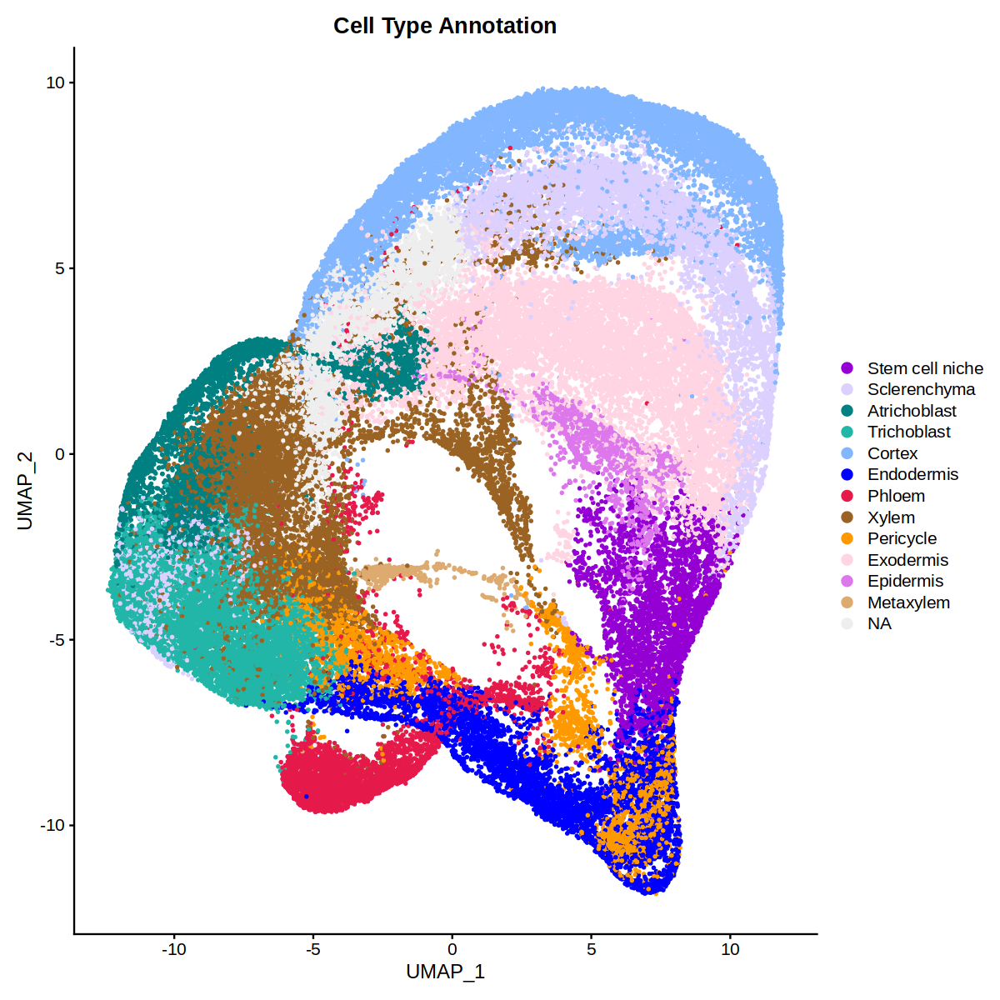

In [91]:
# Plot marker annotation
#order <- c("Stem cell niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "NA")
order <- c("Stem cell niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Early Metaxylem", "Metaxylem", "NA")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=10, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color, pt.size=0.5)+ggtitle("Cell Type Annotation")

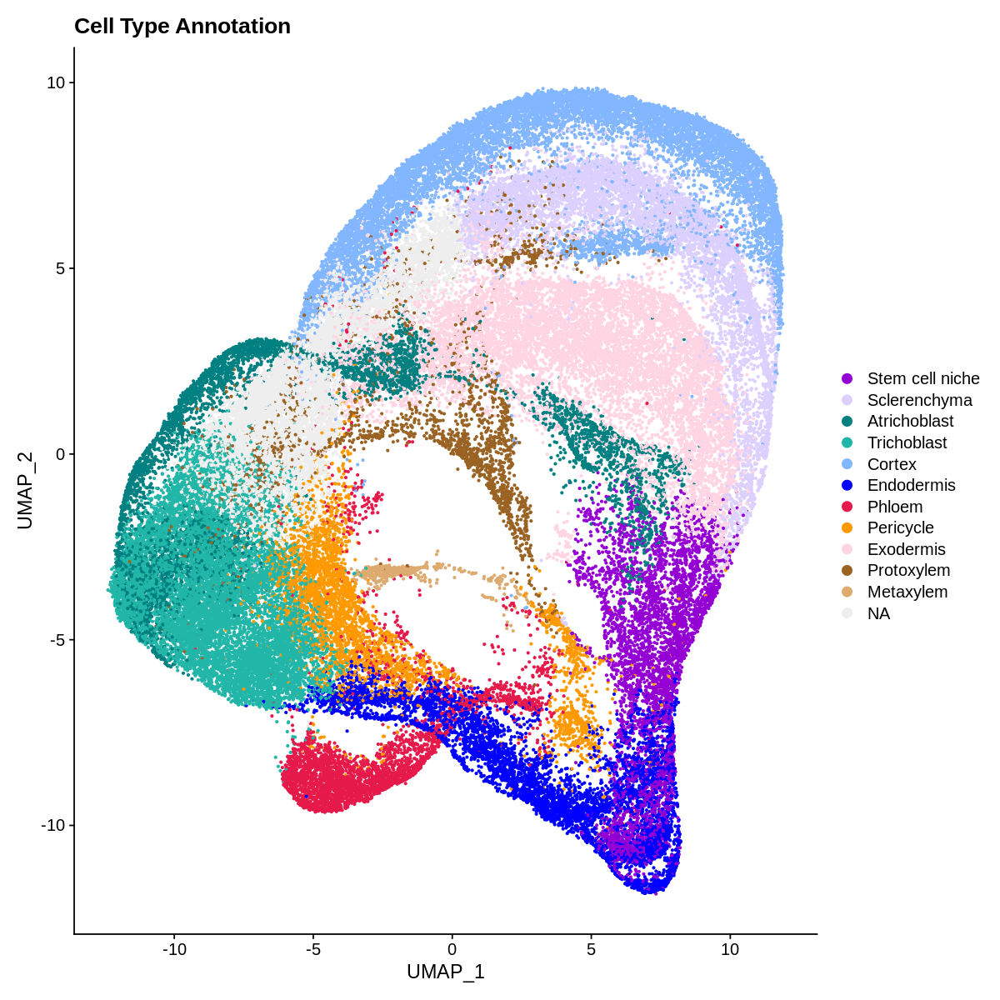

In [326]:
# Plot marker annotation
order <- c("Stem cell niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "NA")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=10, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color, pt.size=0.5)+ggtitle("Cell Type Annotation")

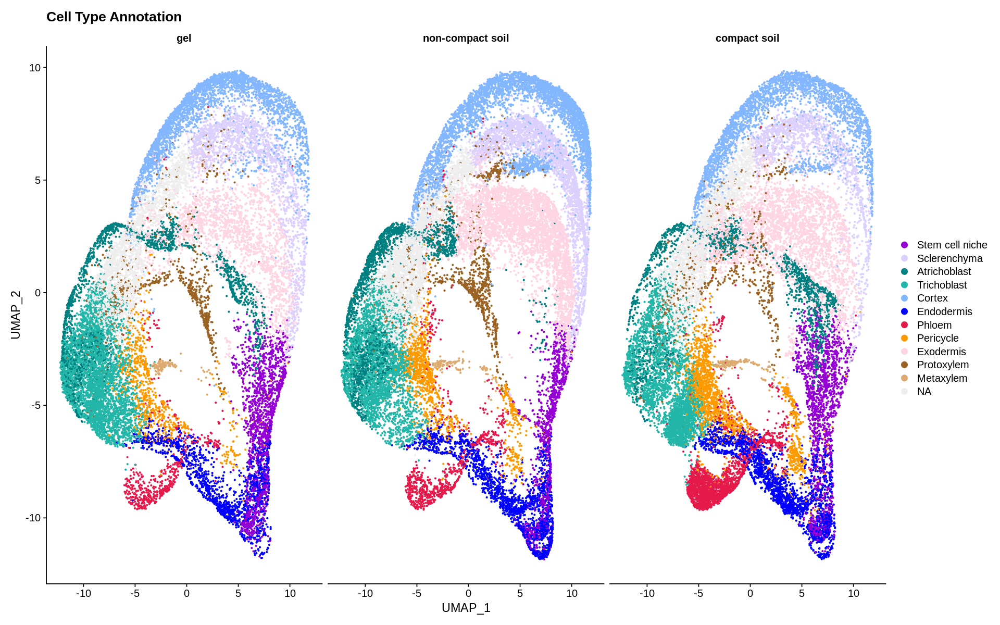

In [327]:
options(repr.plot.width=16, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", split.by="condition", cols = color, pt.size=0.5)+ggtitle("Cell Type Annotation")

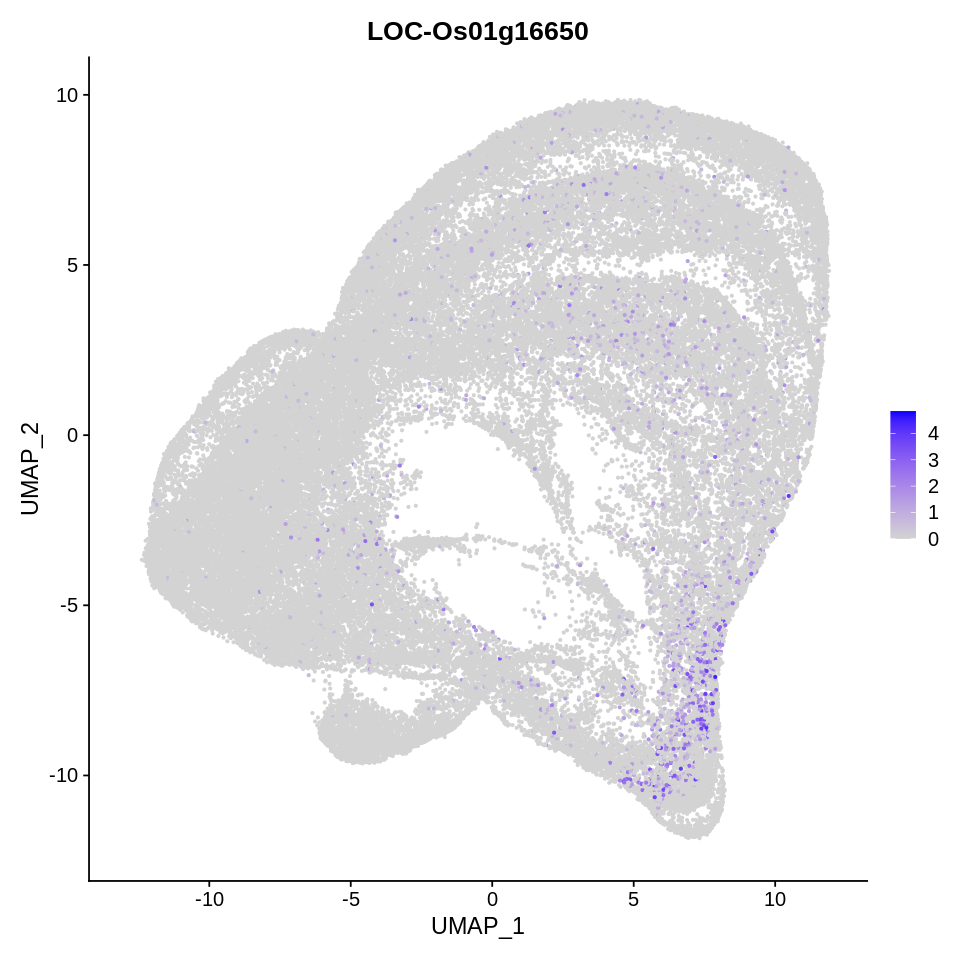

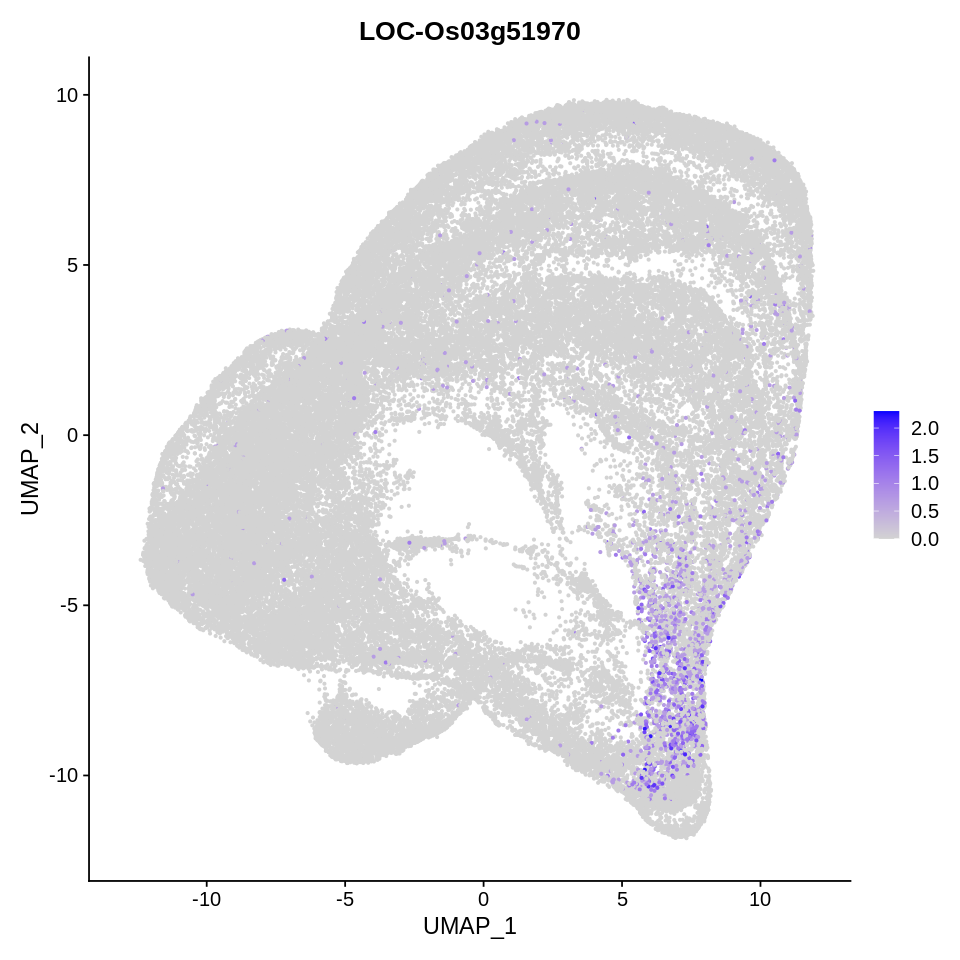

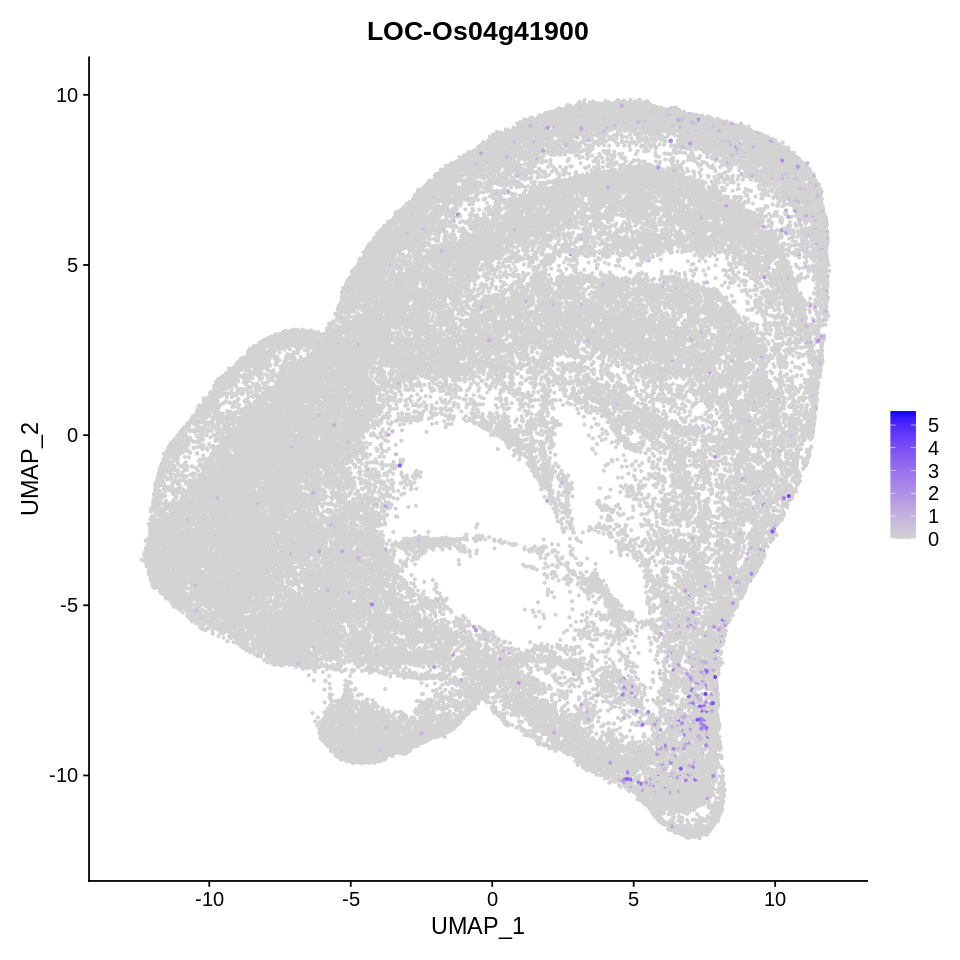

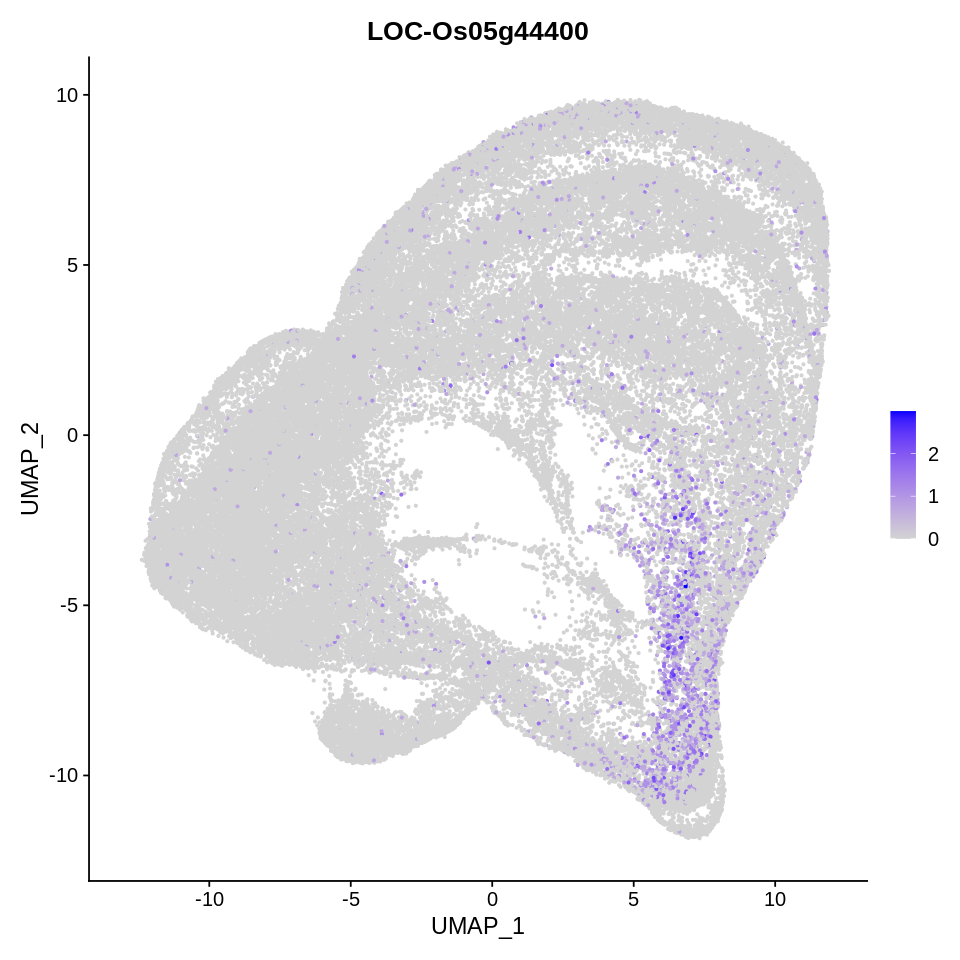

In [328]:
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Stem cell niche"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

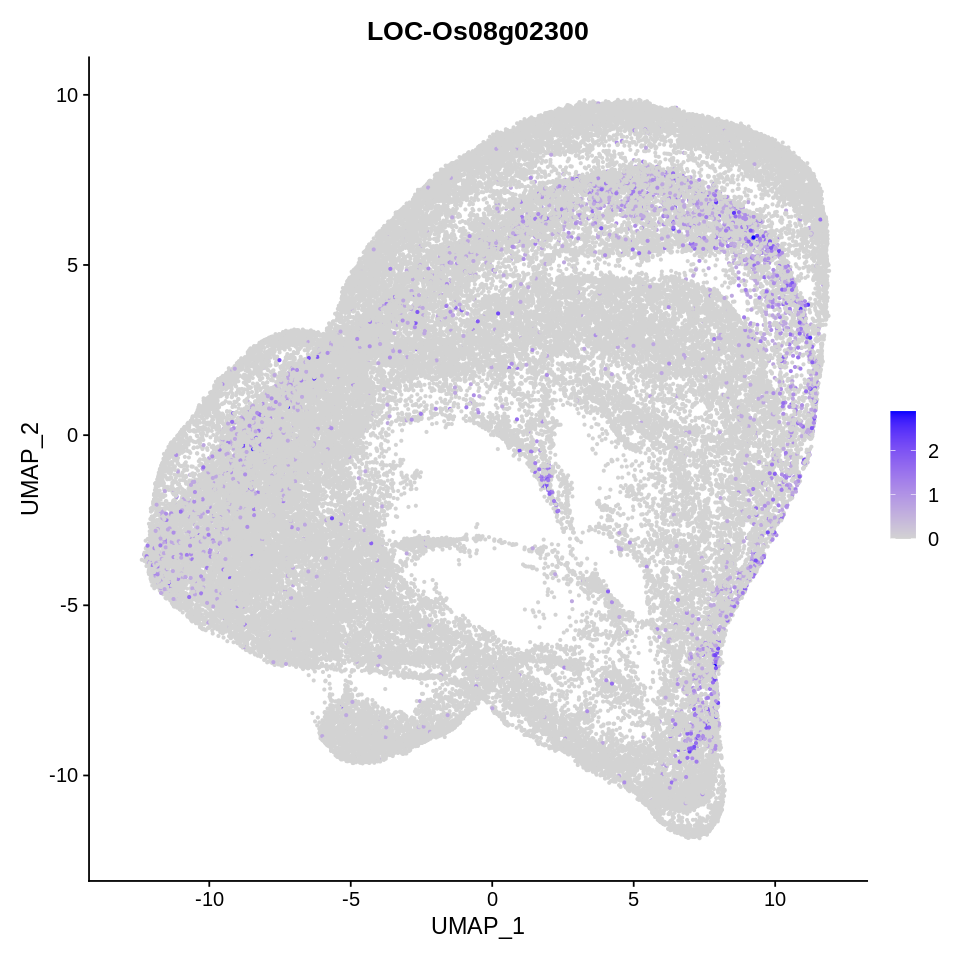

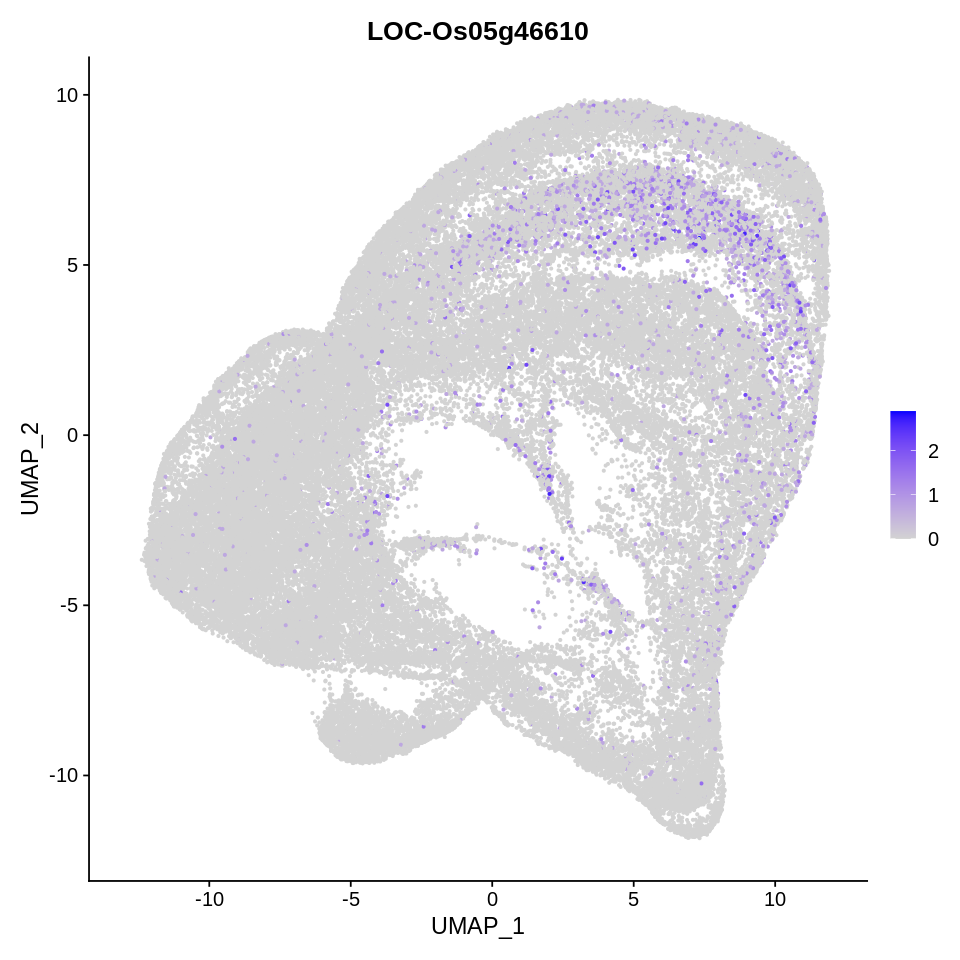

In [339]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Sclerenchyma"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

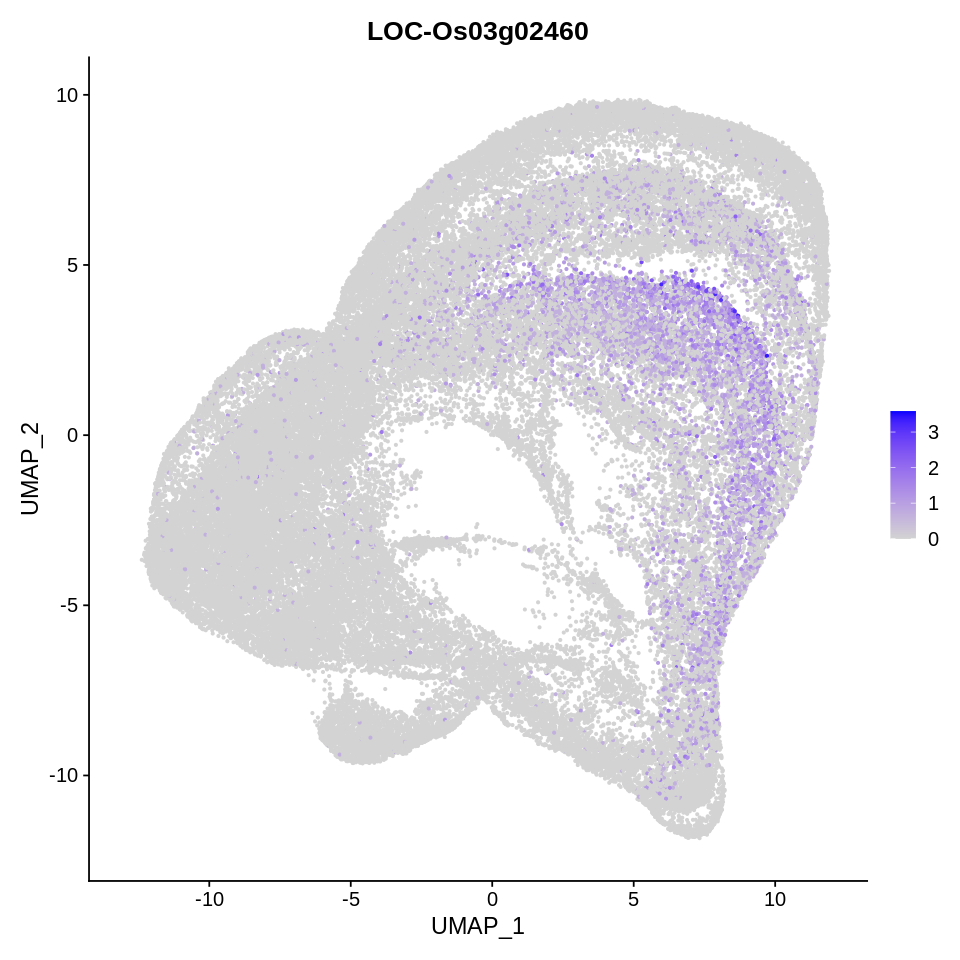

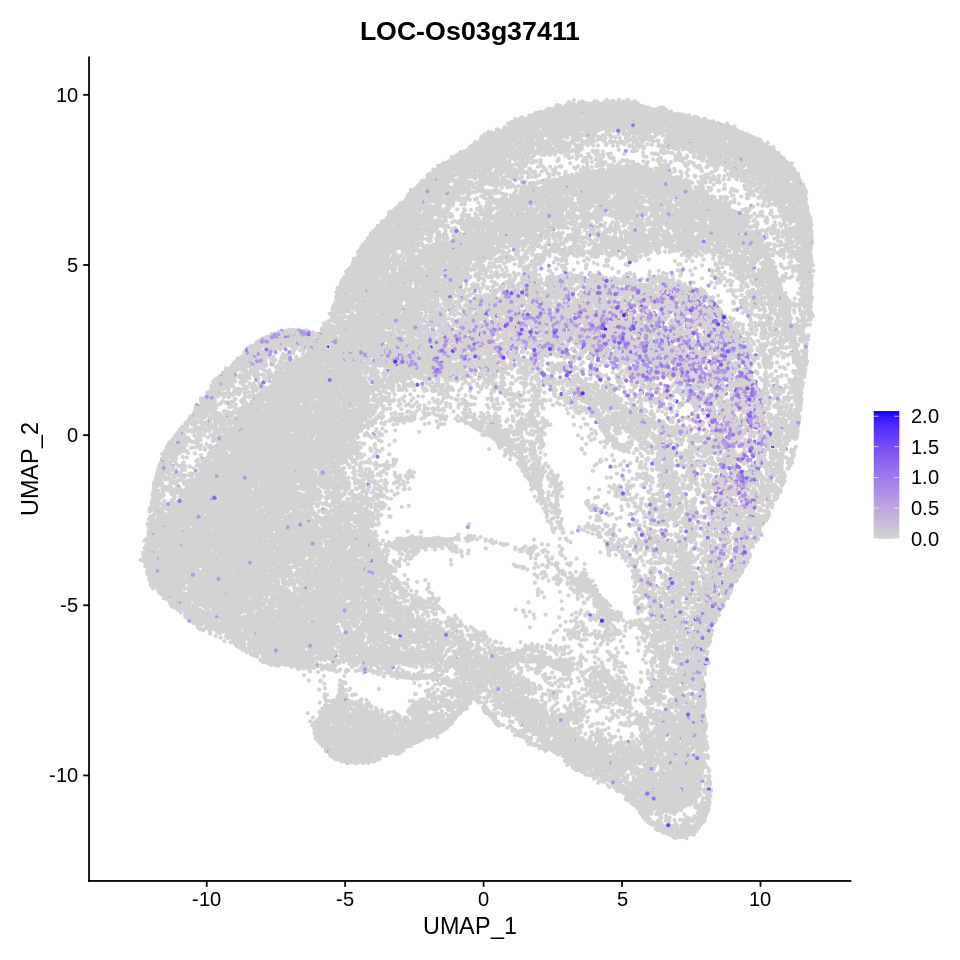

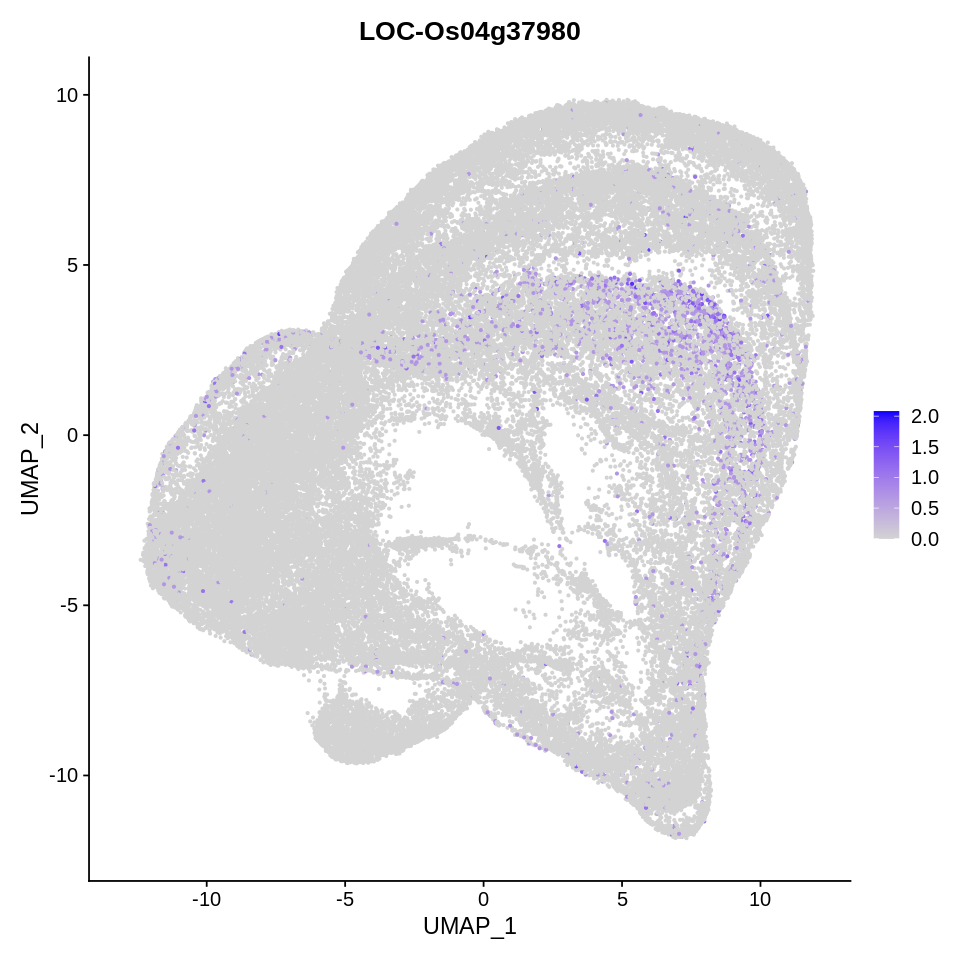

In [329]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Exodermis"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

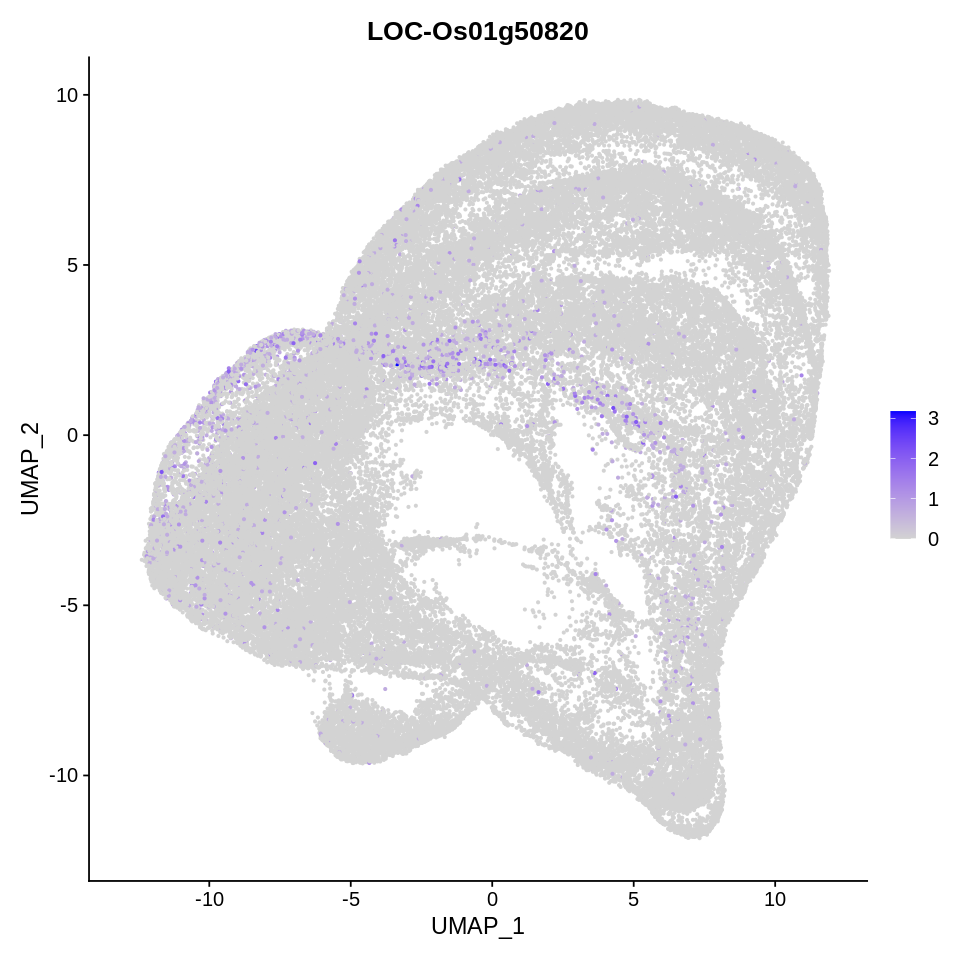

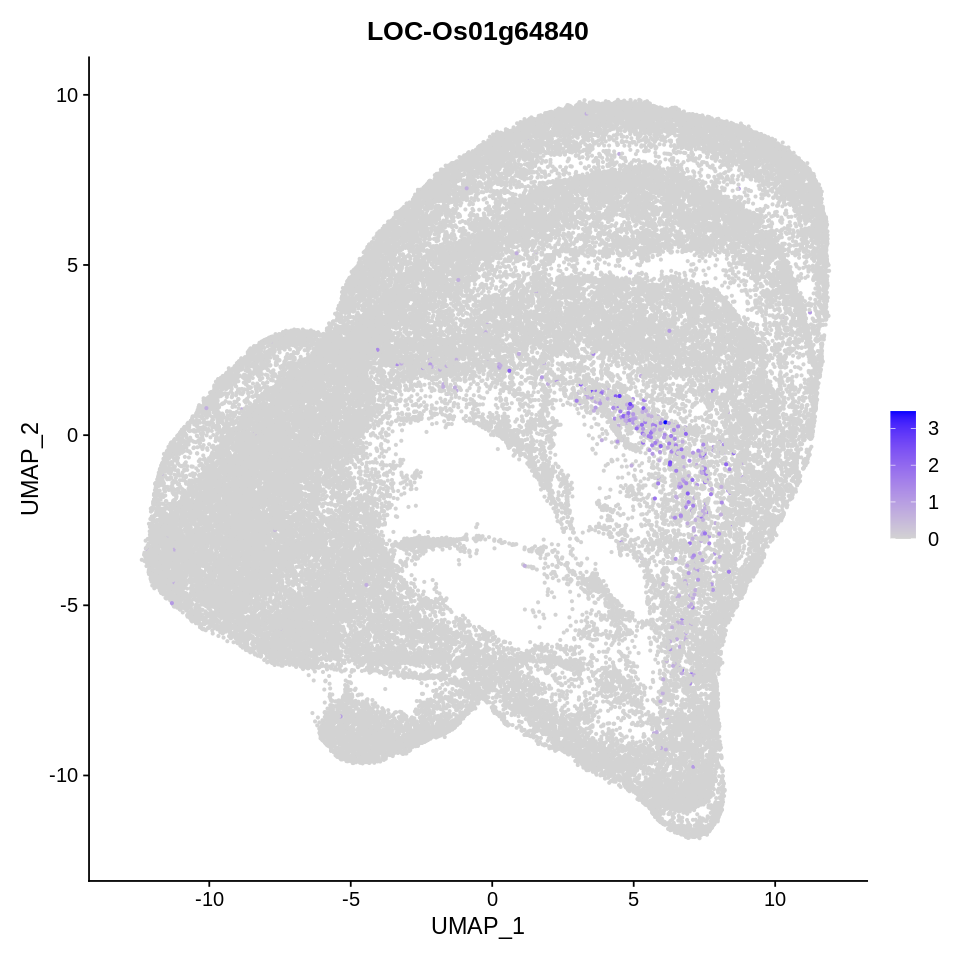

In [330]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Atrichoblast"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

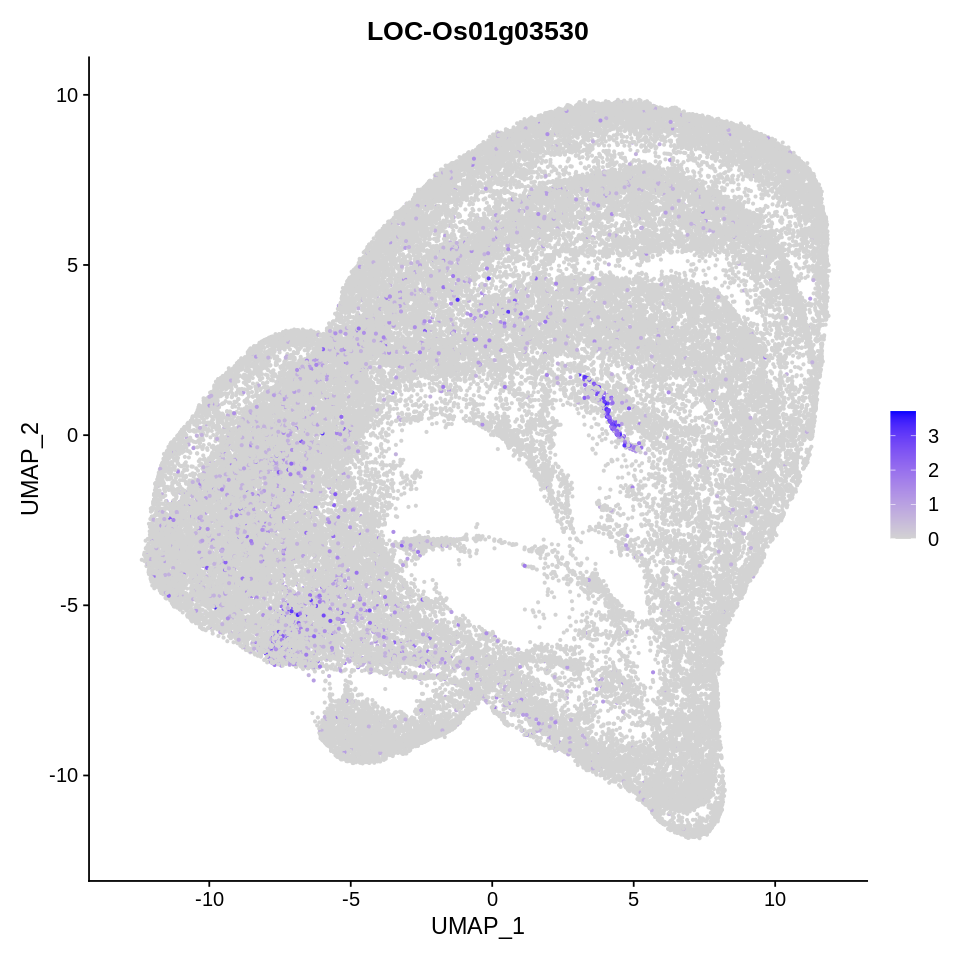

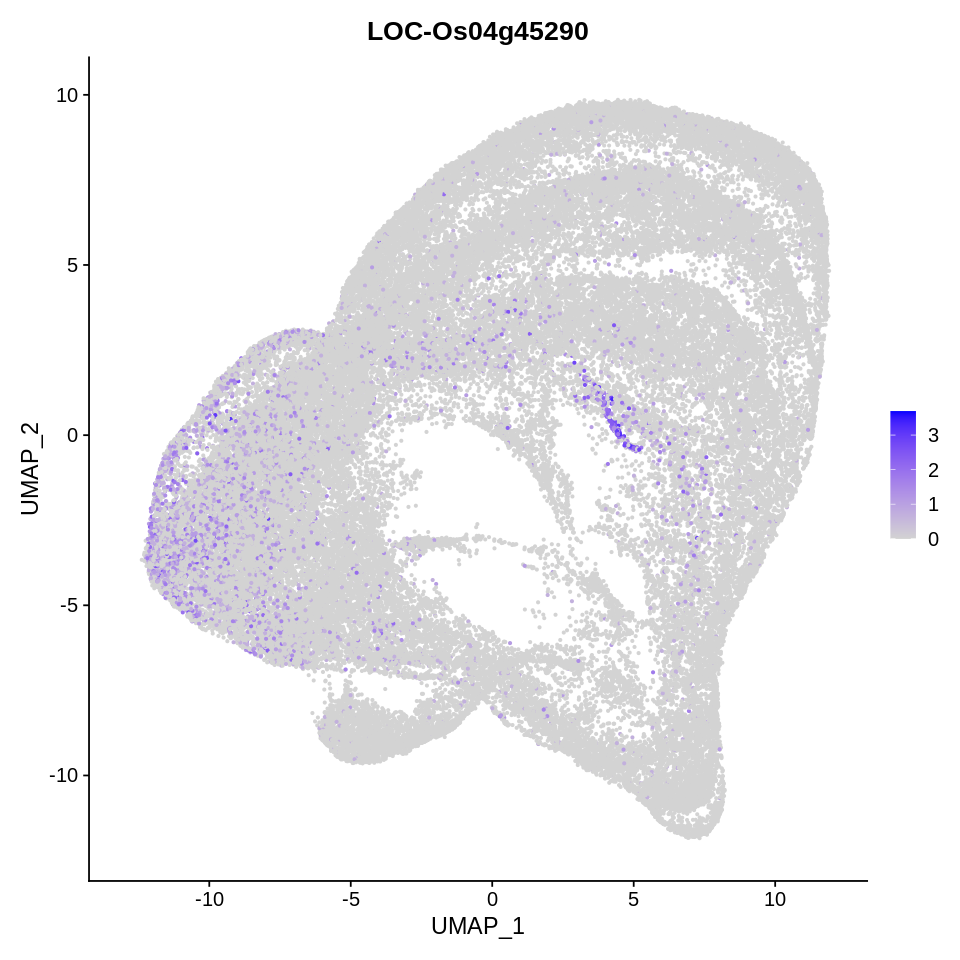

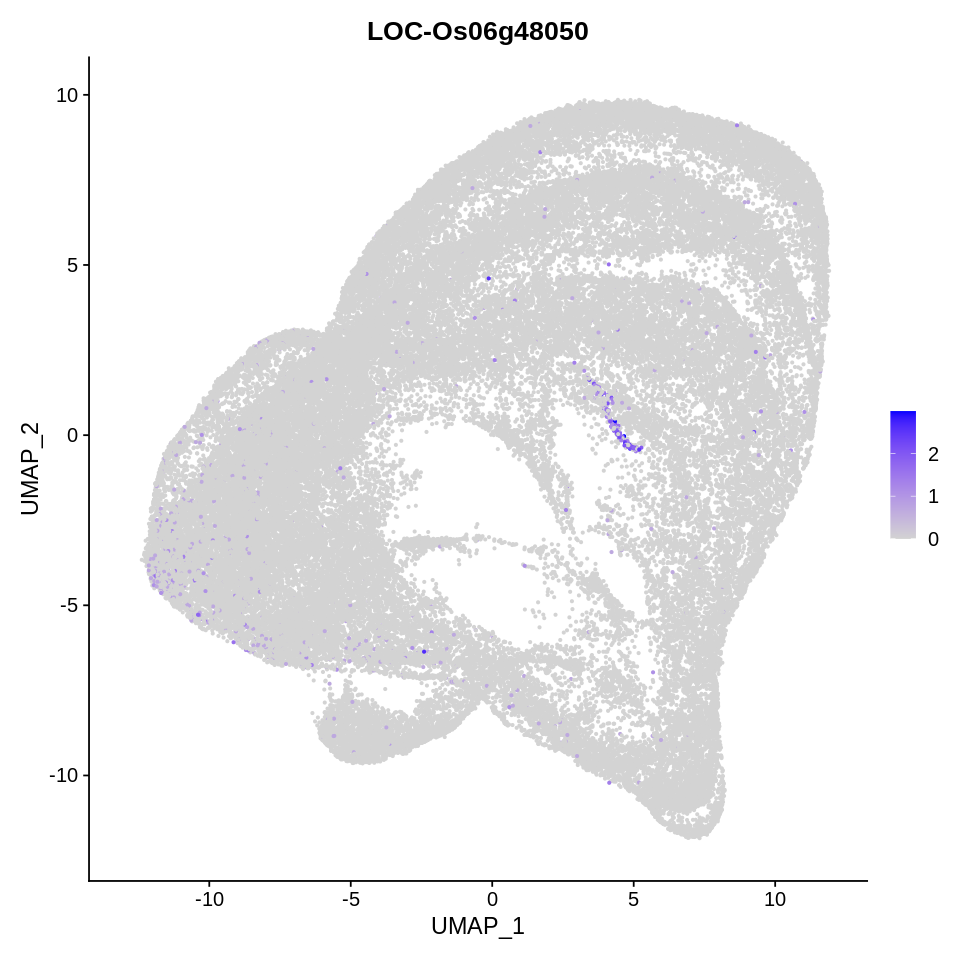

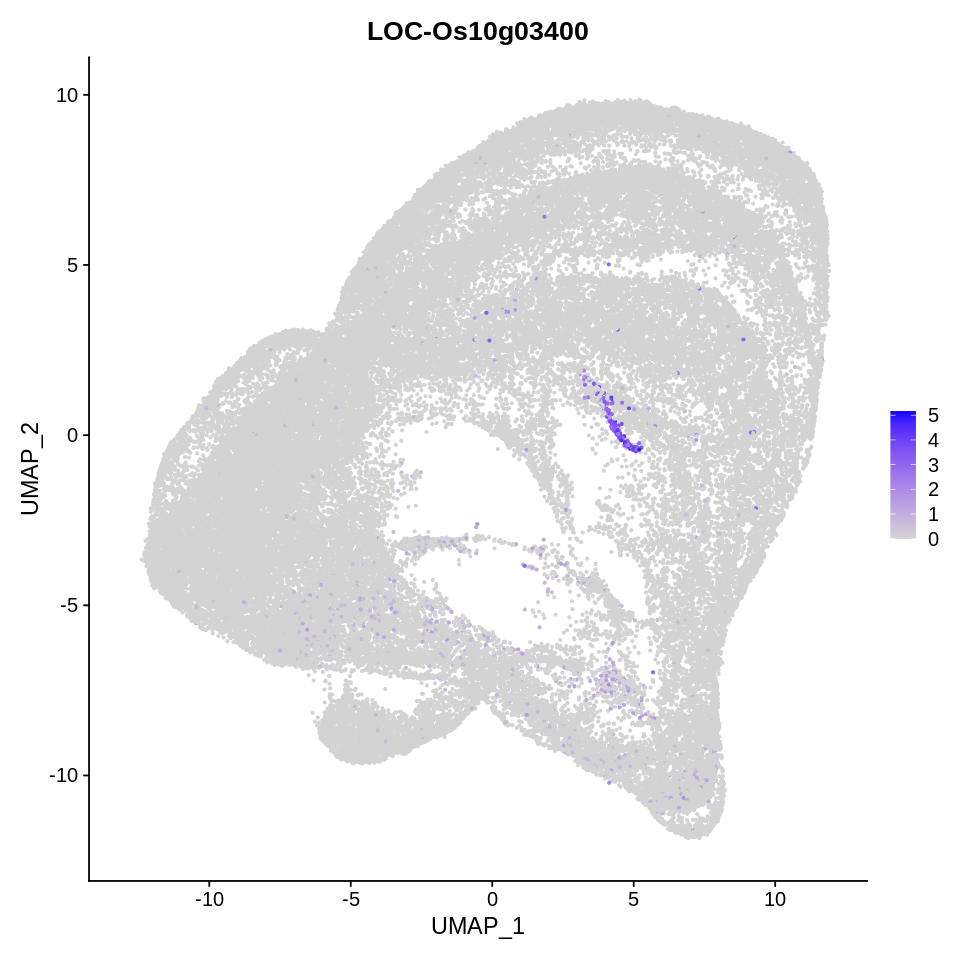

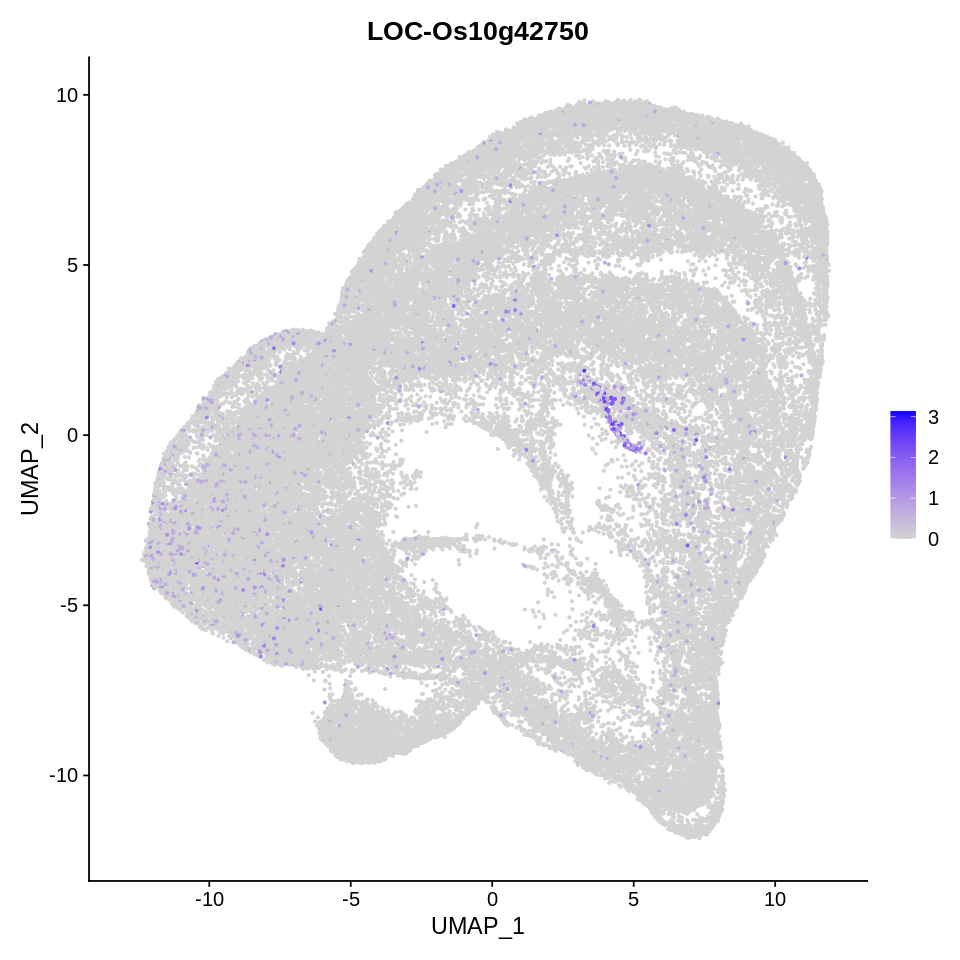

In [331]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Trichoblast"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

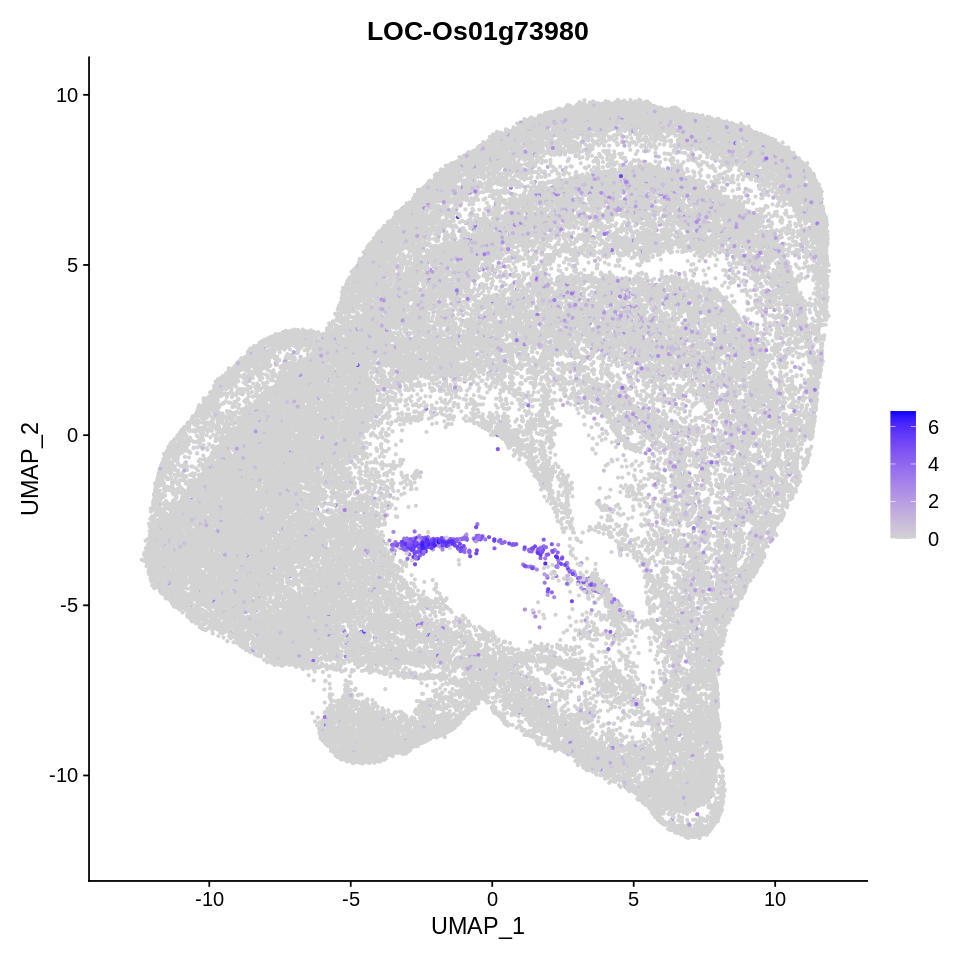

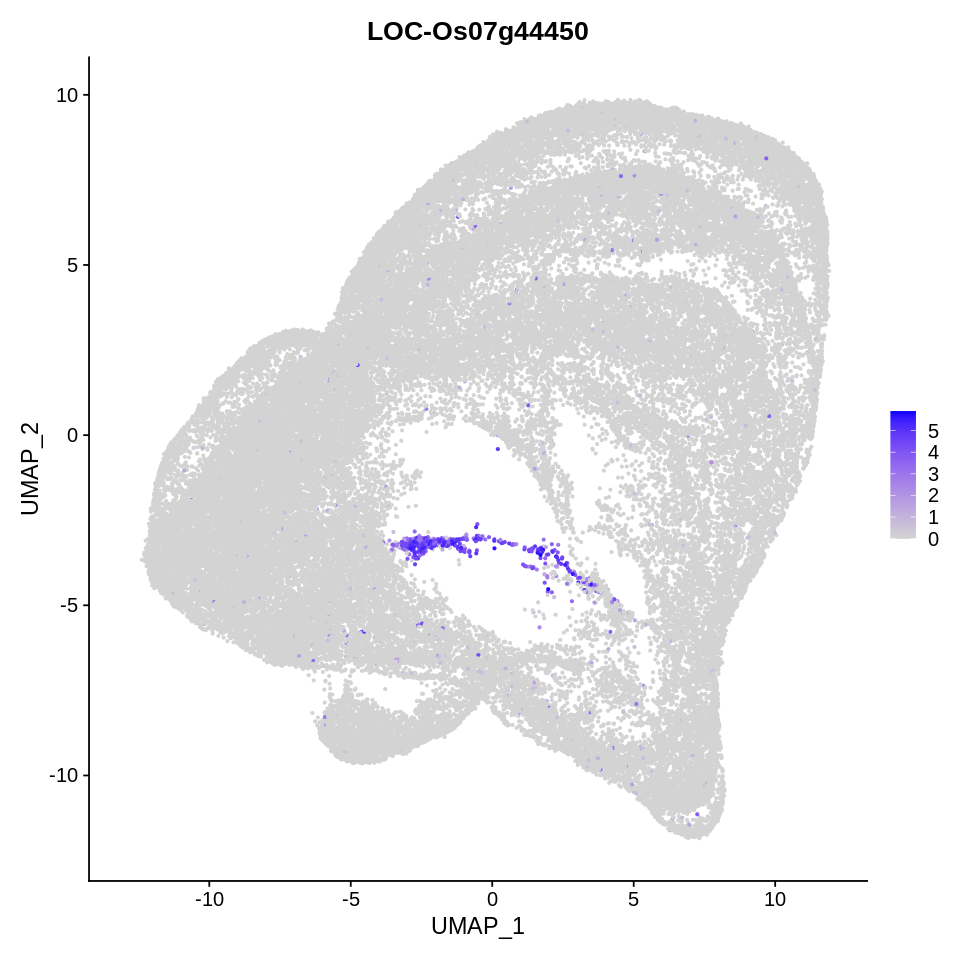

In [332]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Metaxylem"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

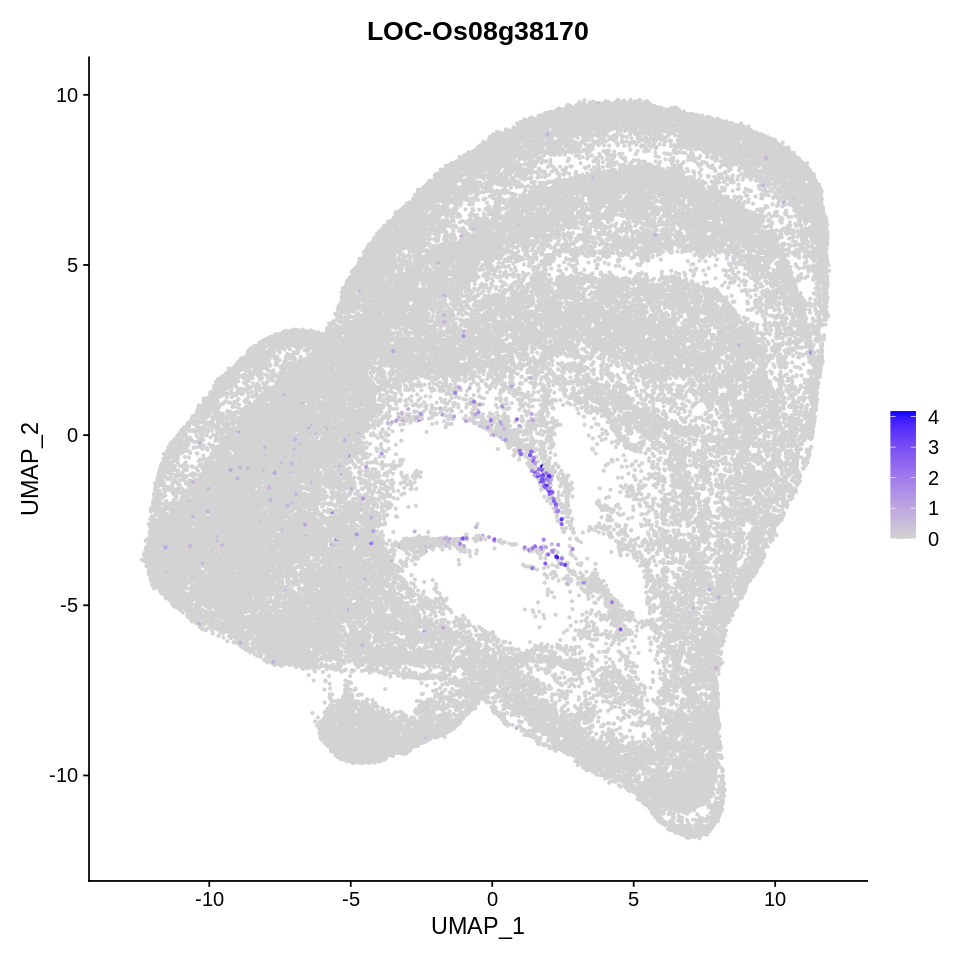

In [333]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Protoxylem"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

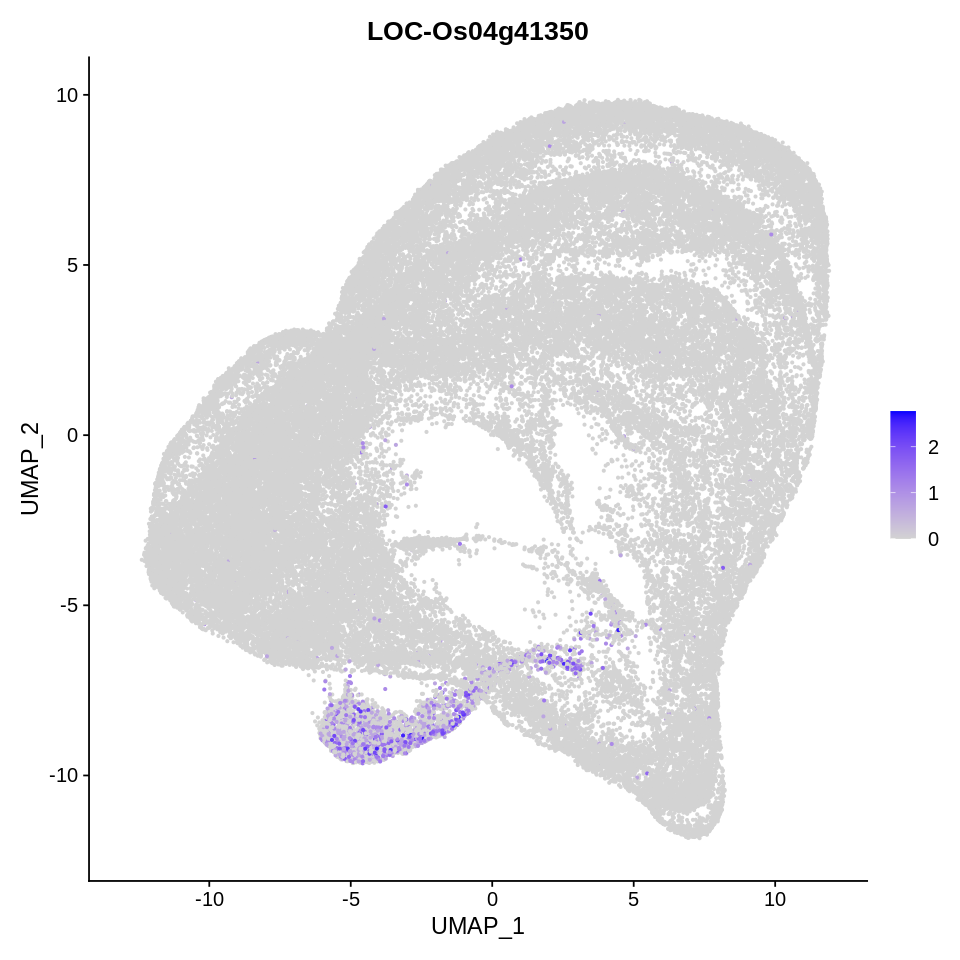

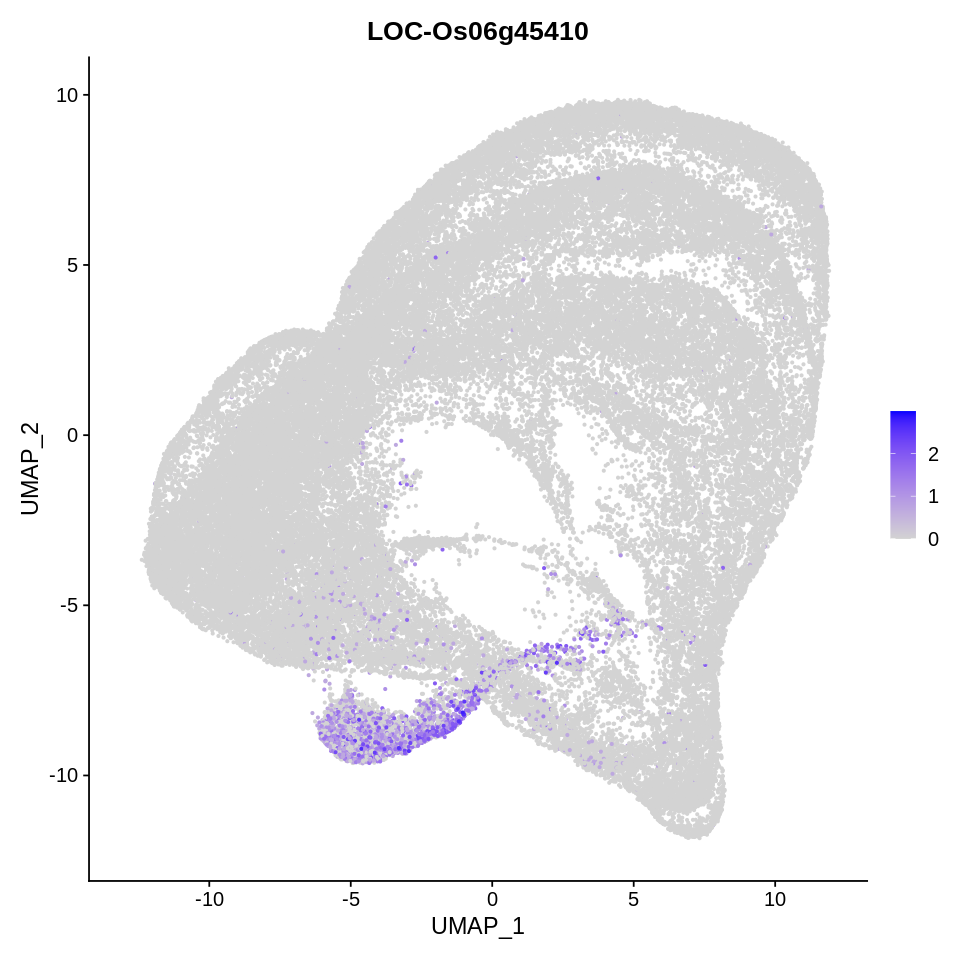

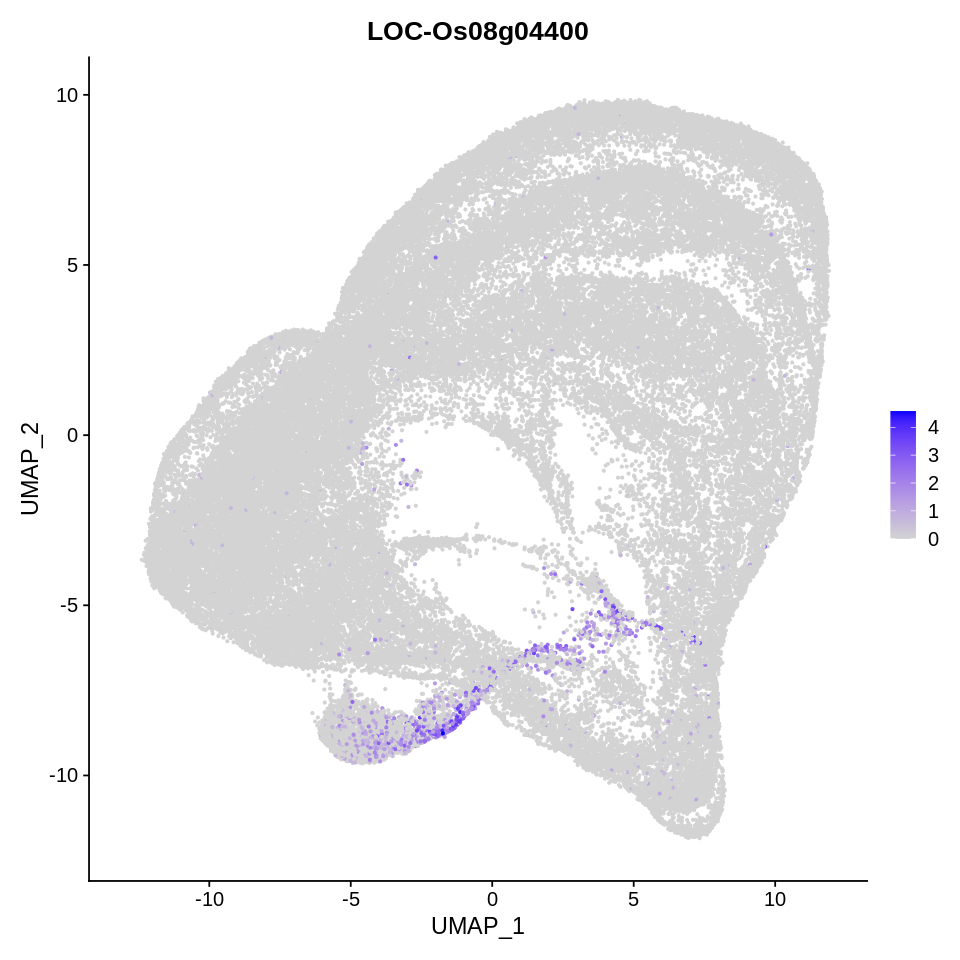

In [334]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Phloem"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

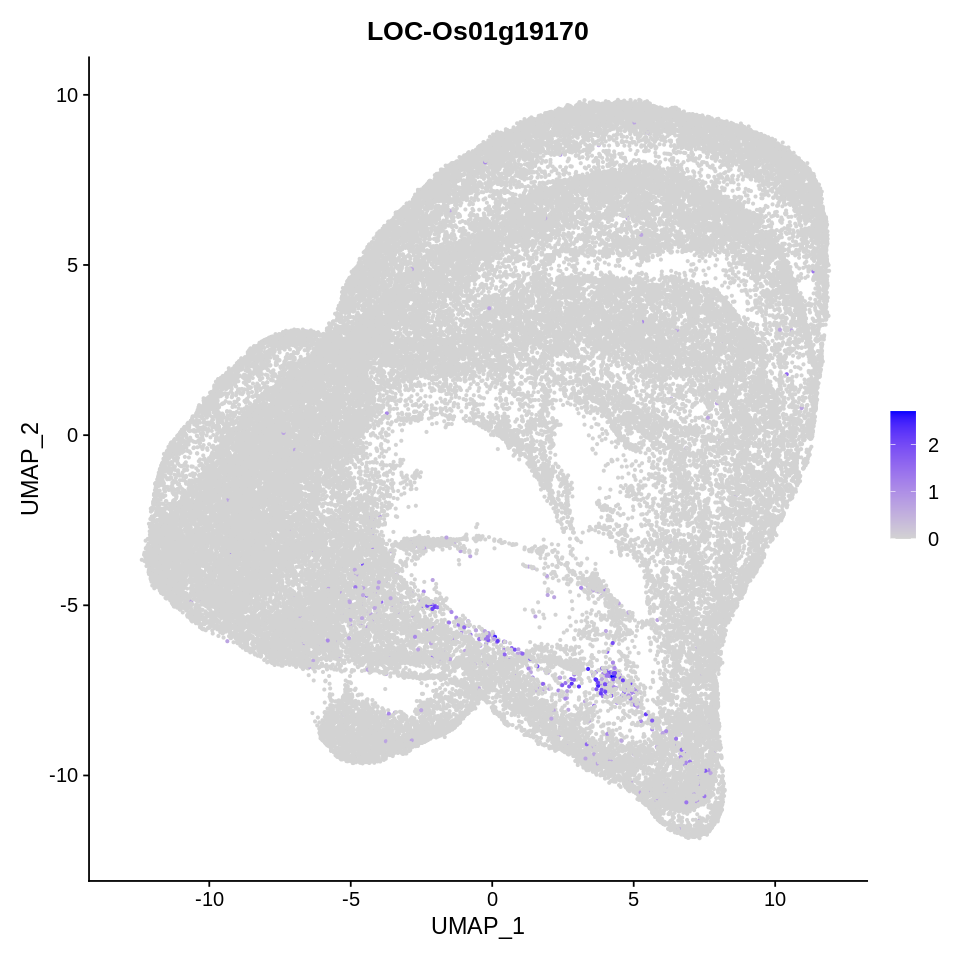

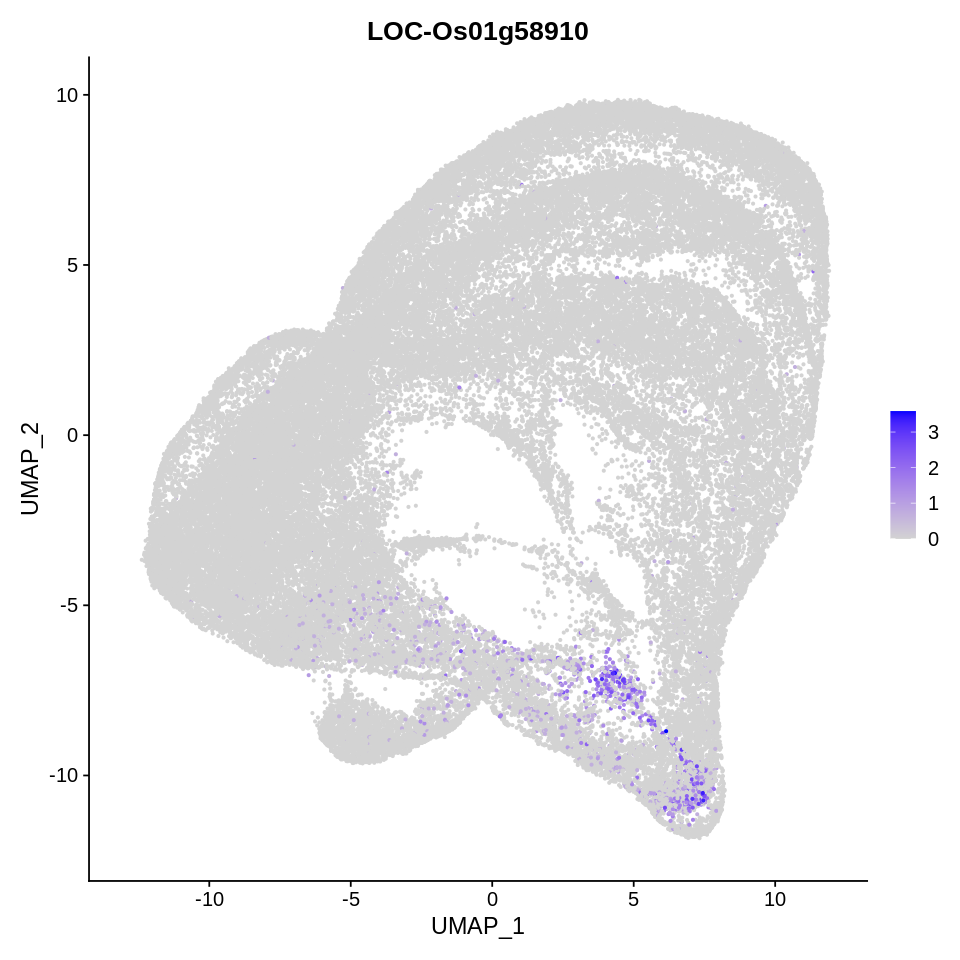

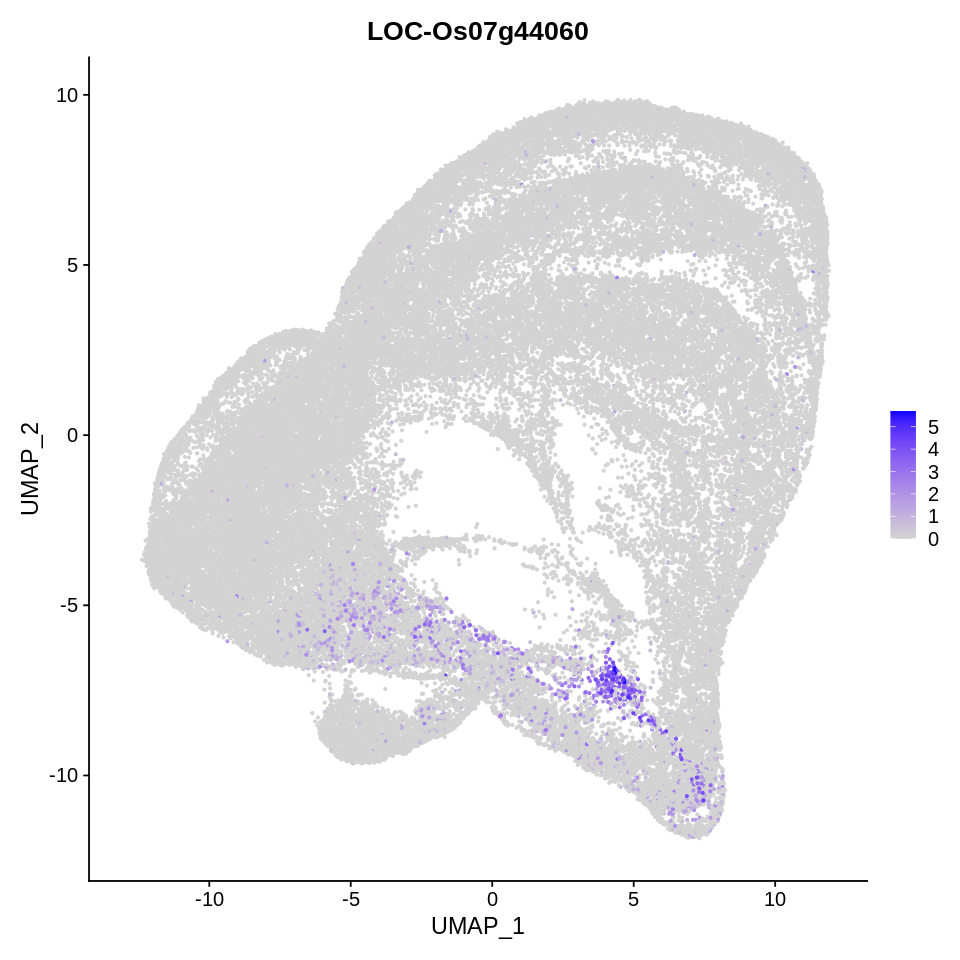

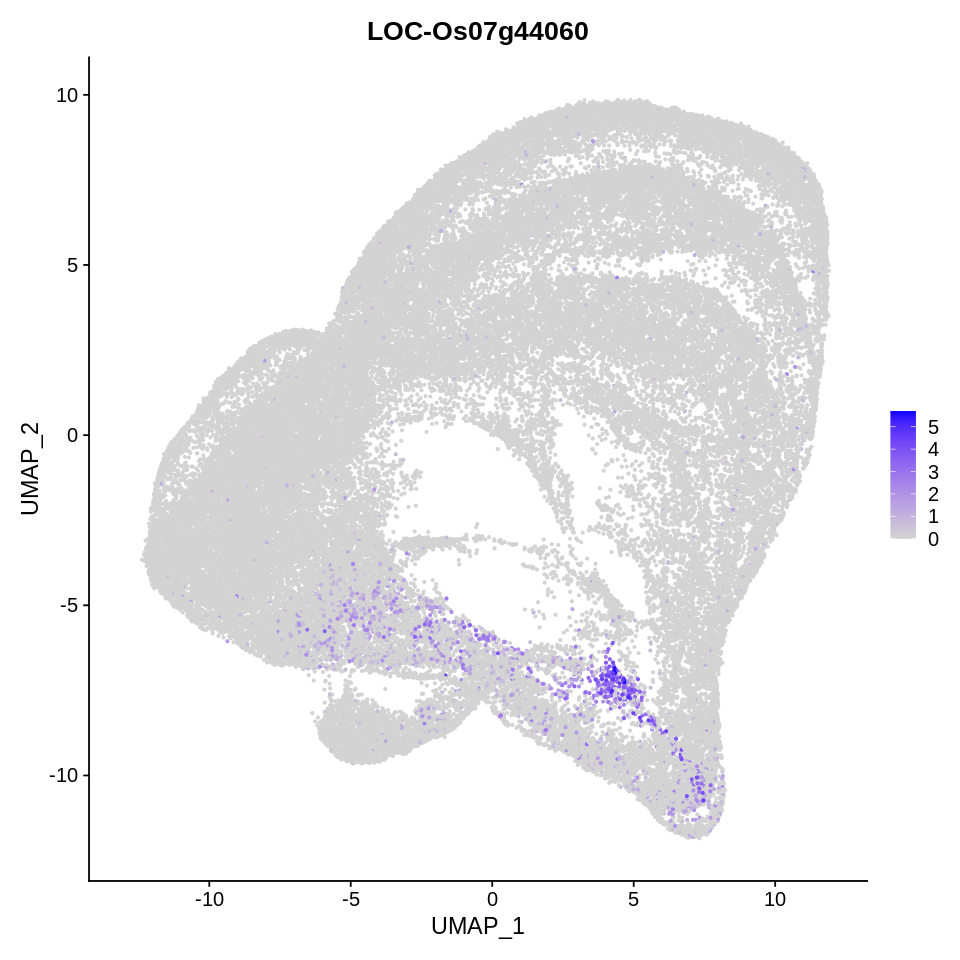

In [335]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Pericycle"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

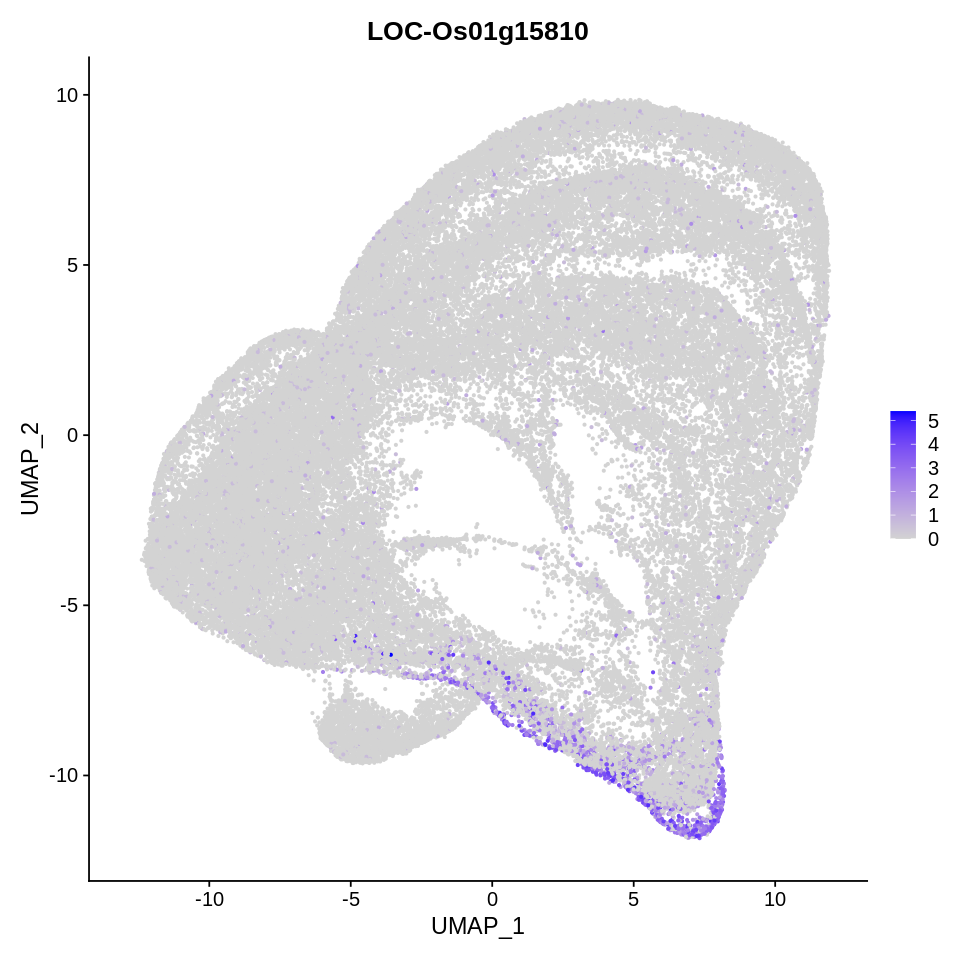

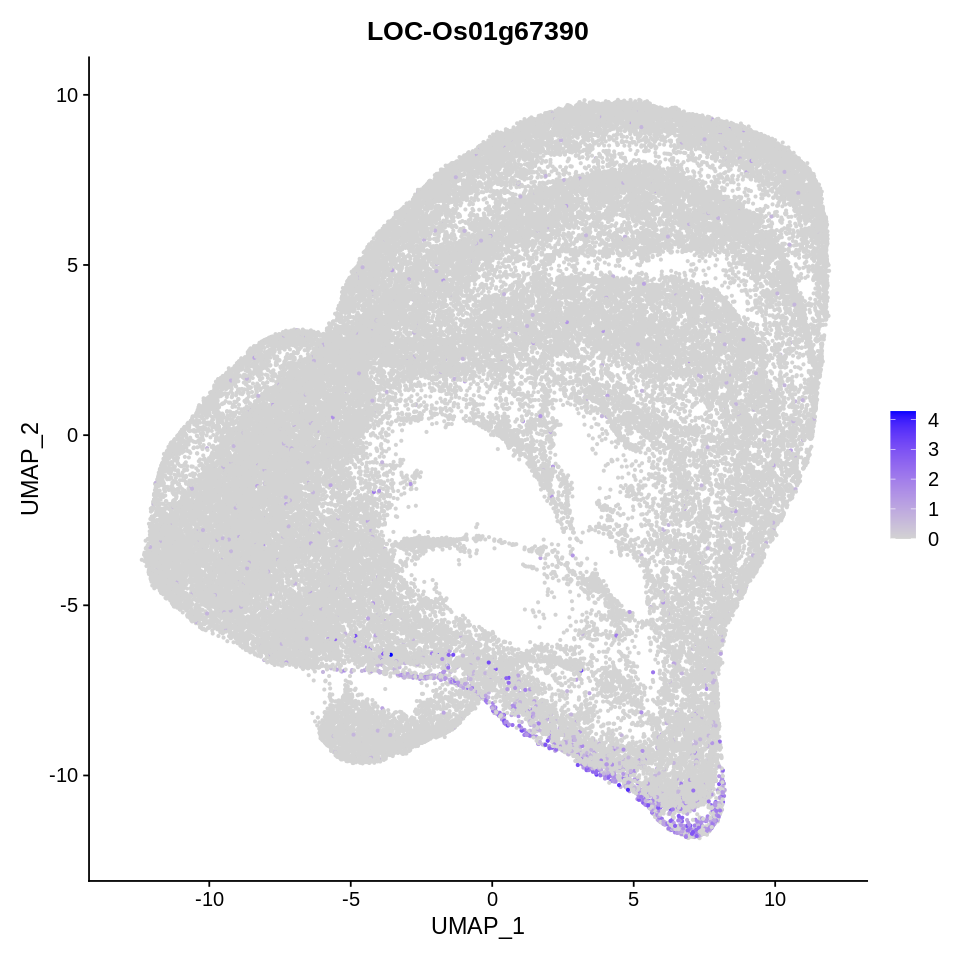

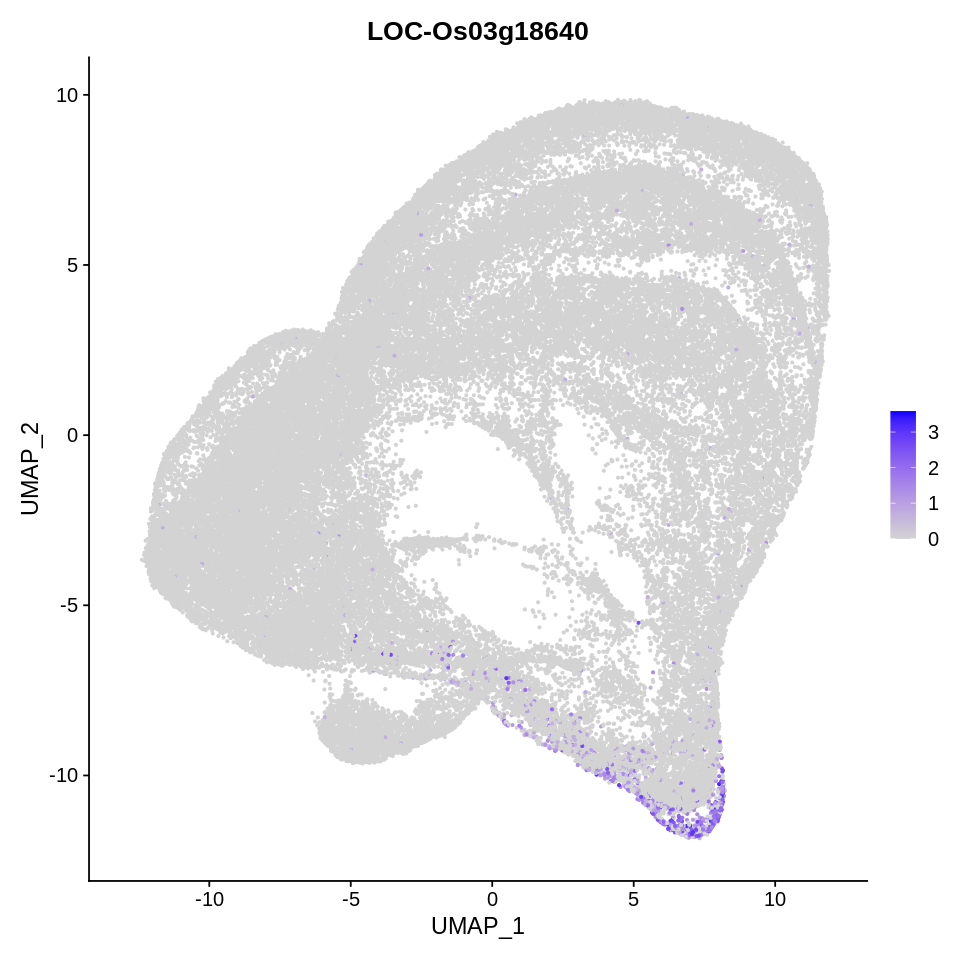

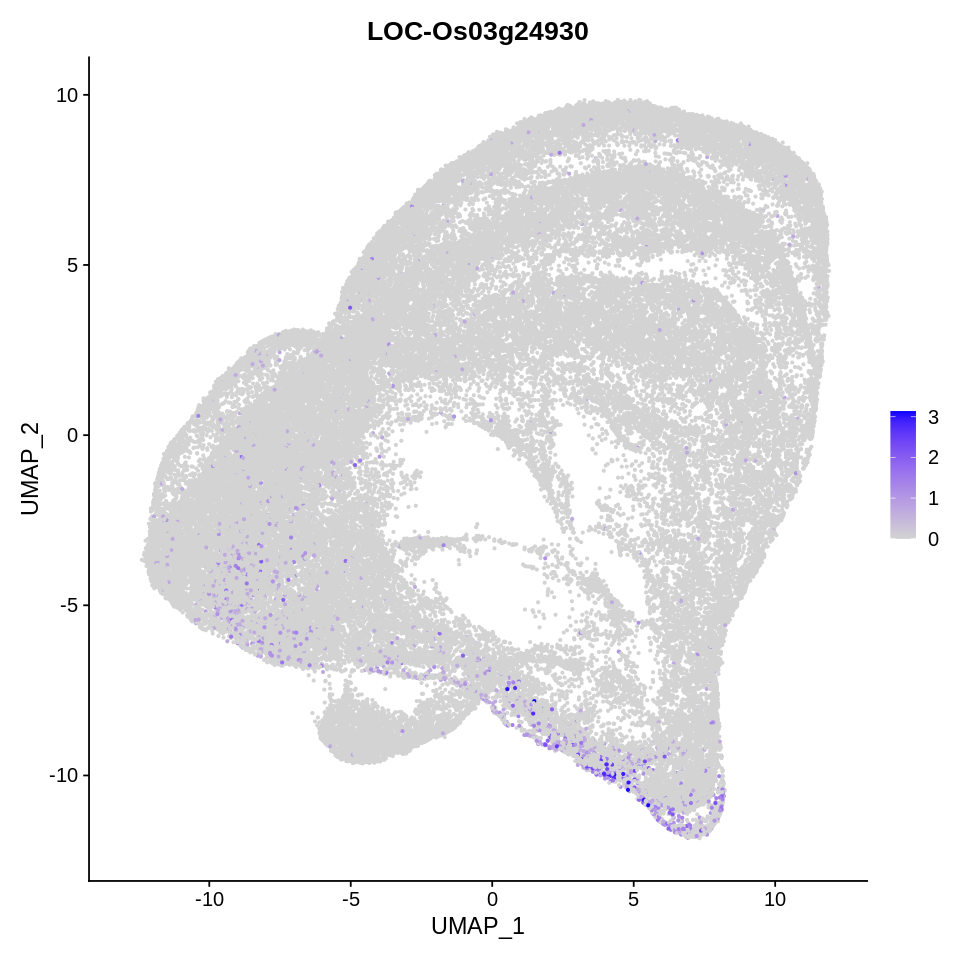

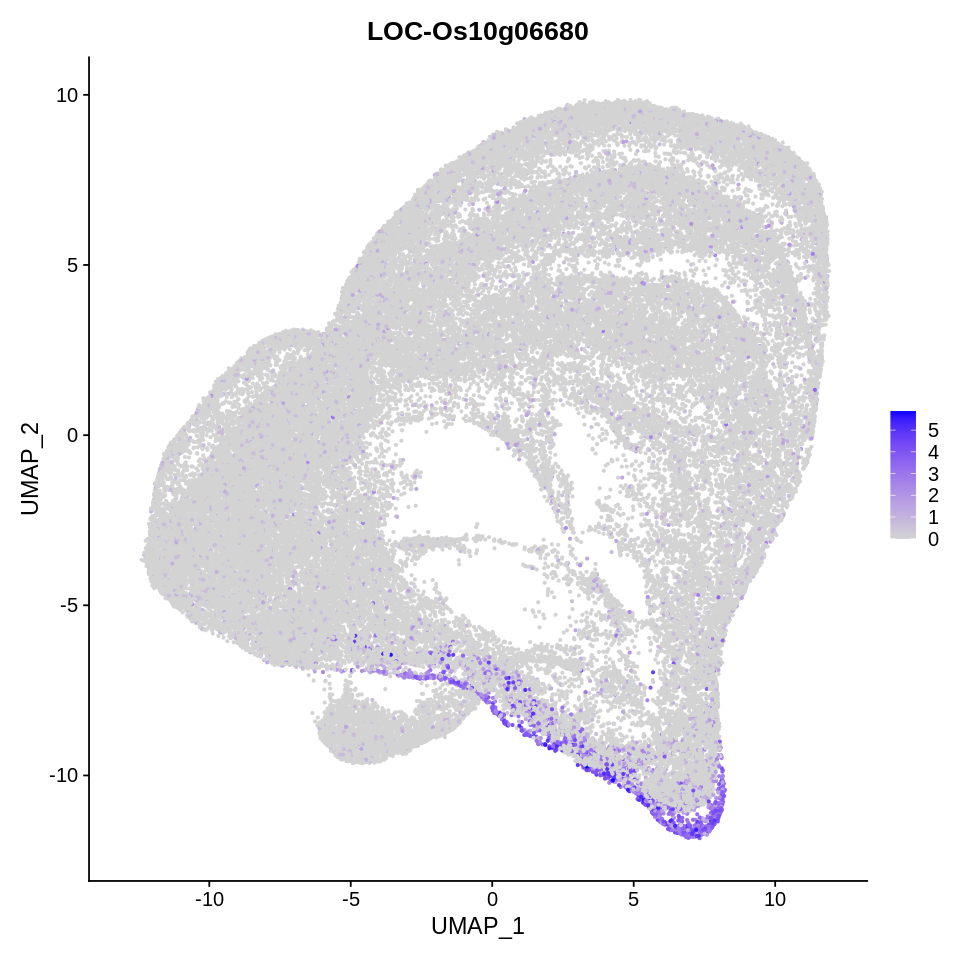

In [336]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Endodermis"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

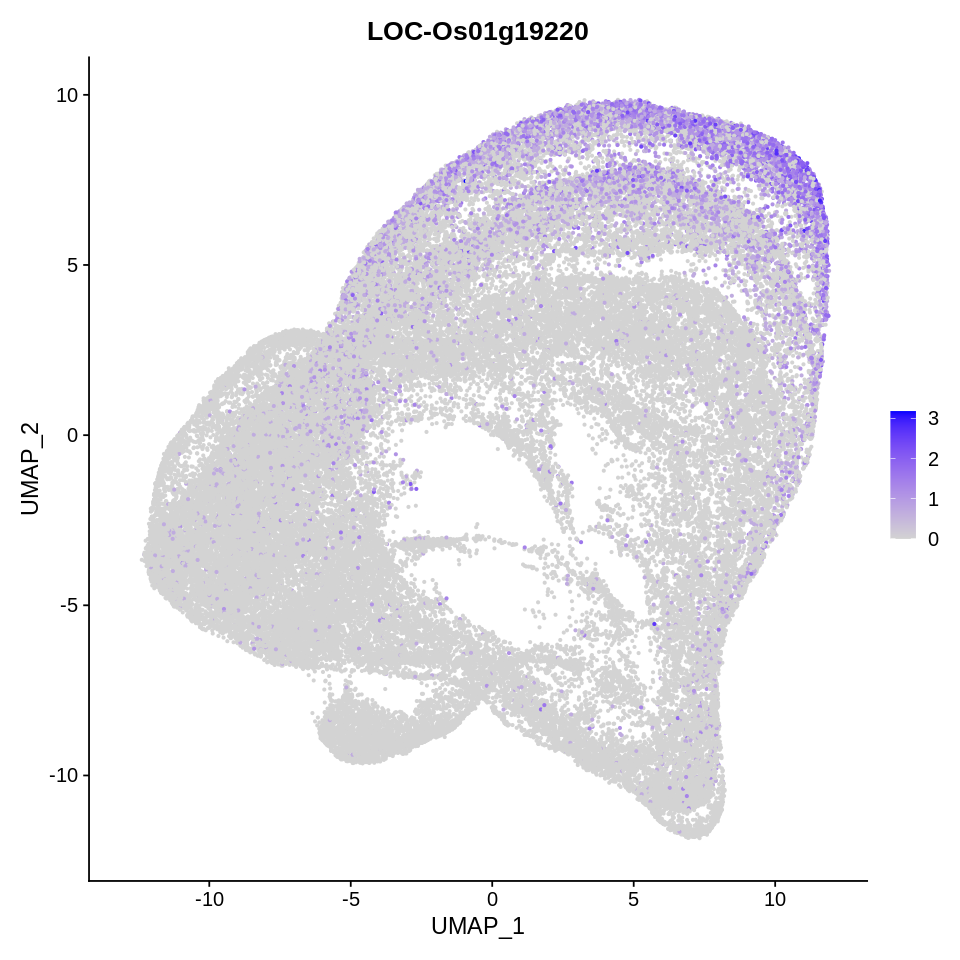

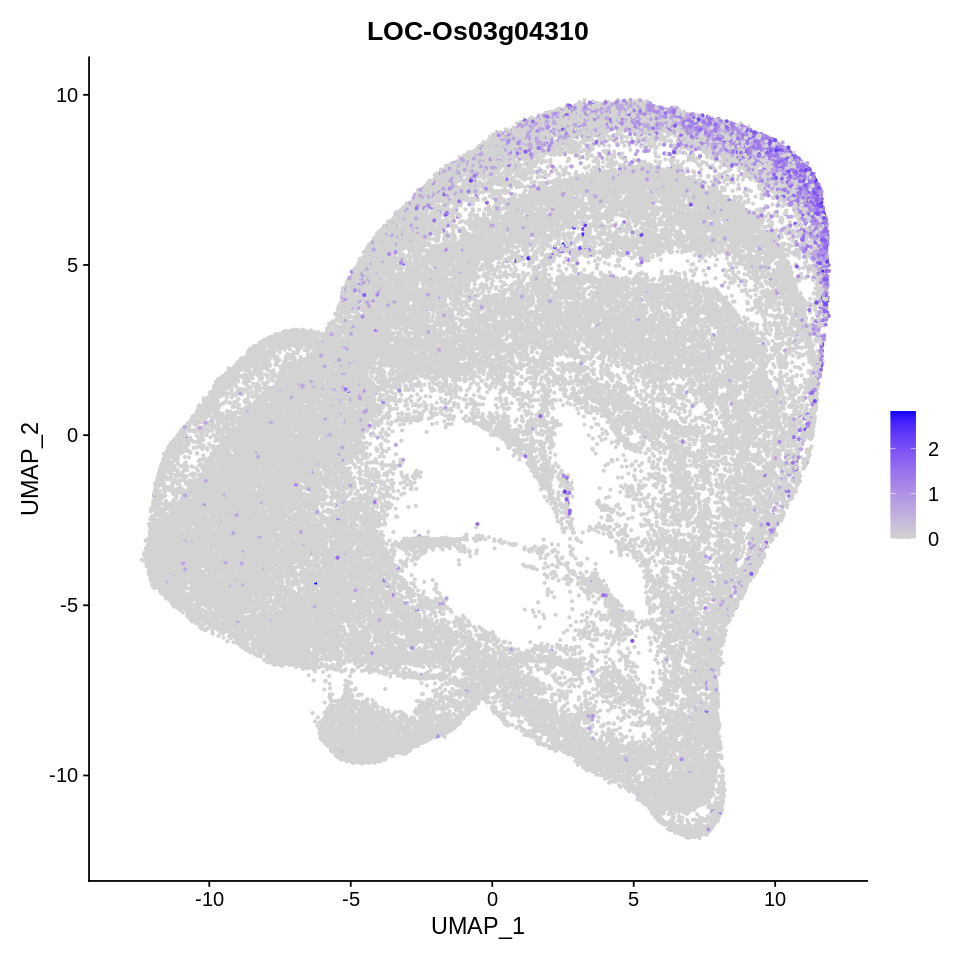

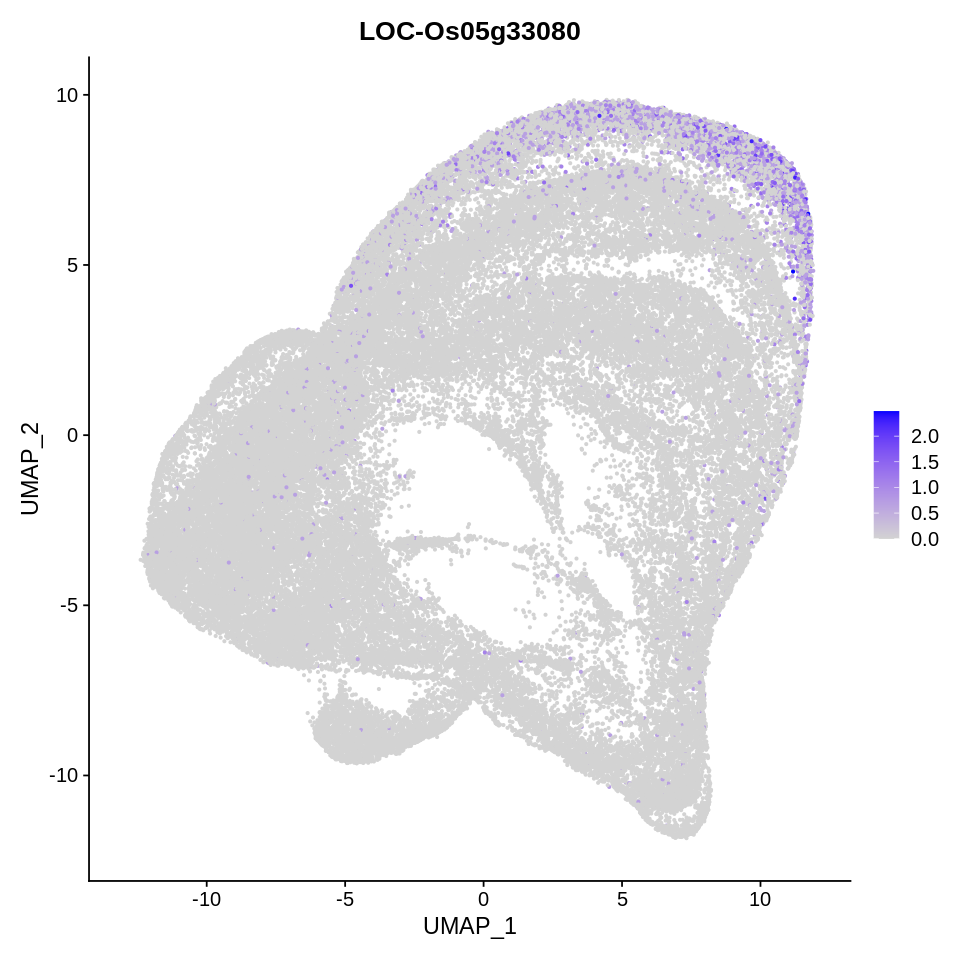

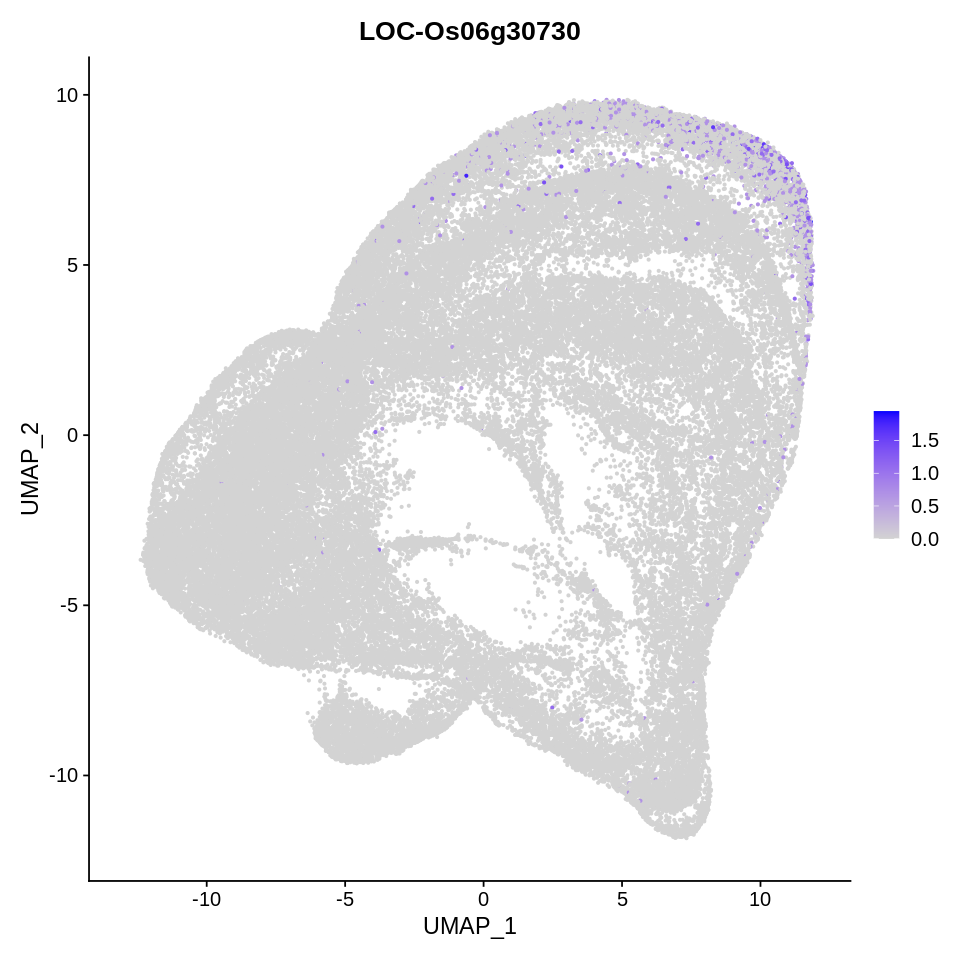

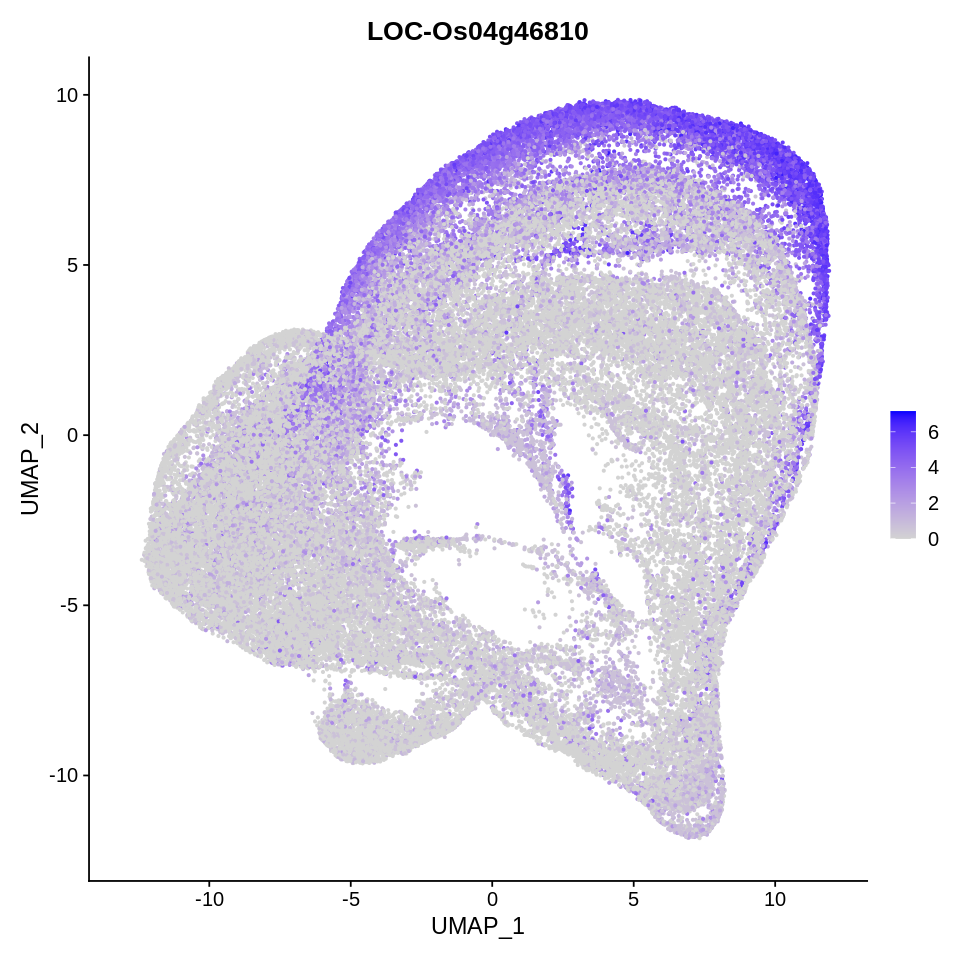

In [337]:
options(repr.plot.width=8, repr.plot.height=8)
for (i in known.good.markers$Gene.ID[known.good.markers$Cell.type=="Cortex"]){
    print(FeaturePlot(rc.integrated, feature= i, pt.size=0.5))
}

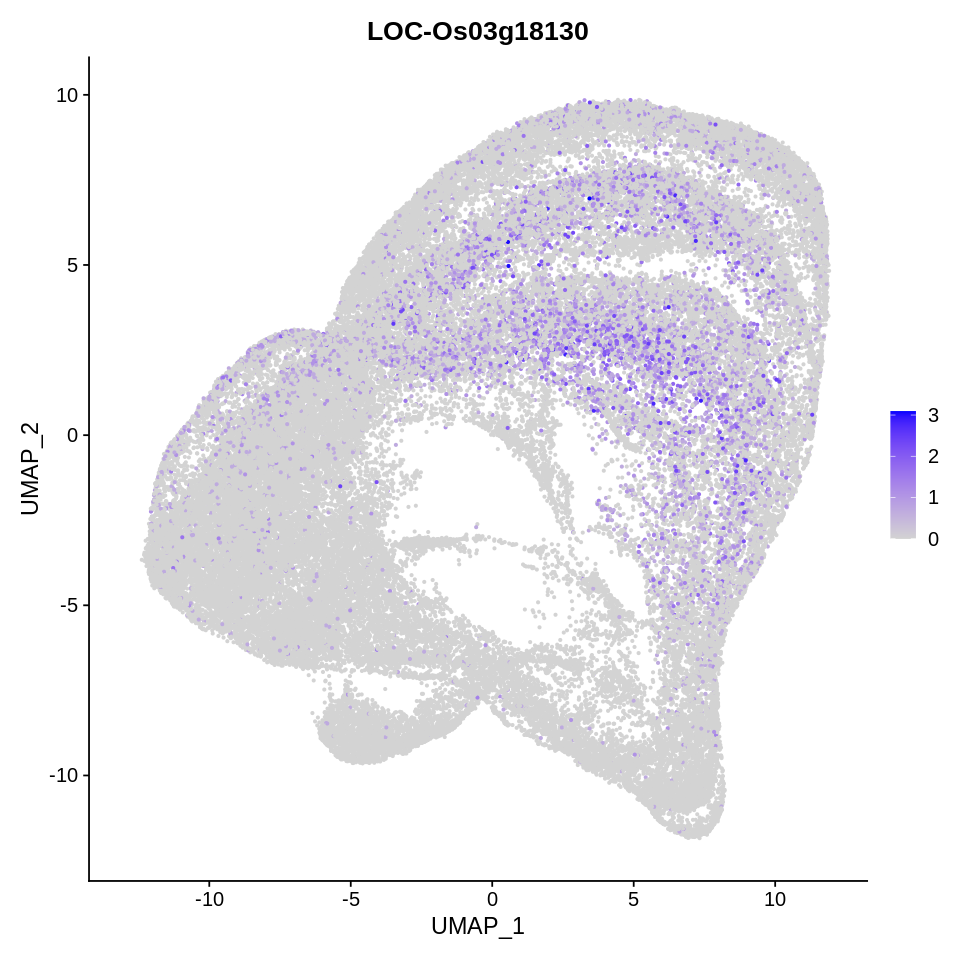

In [153]:
## Root Cap markers
print(FeaturePlot(rc.integrated, feature= "LOC-Os03g18130", pt.size=0.5))

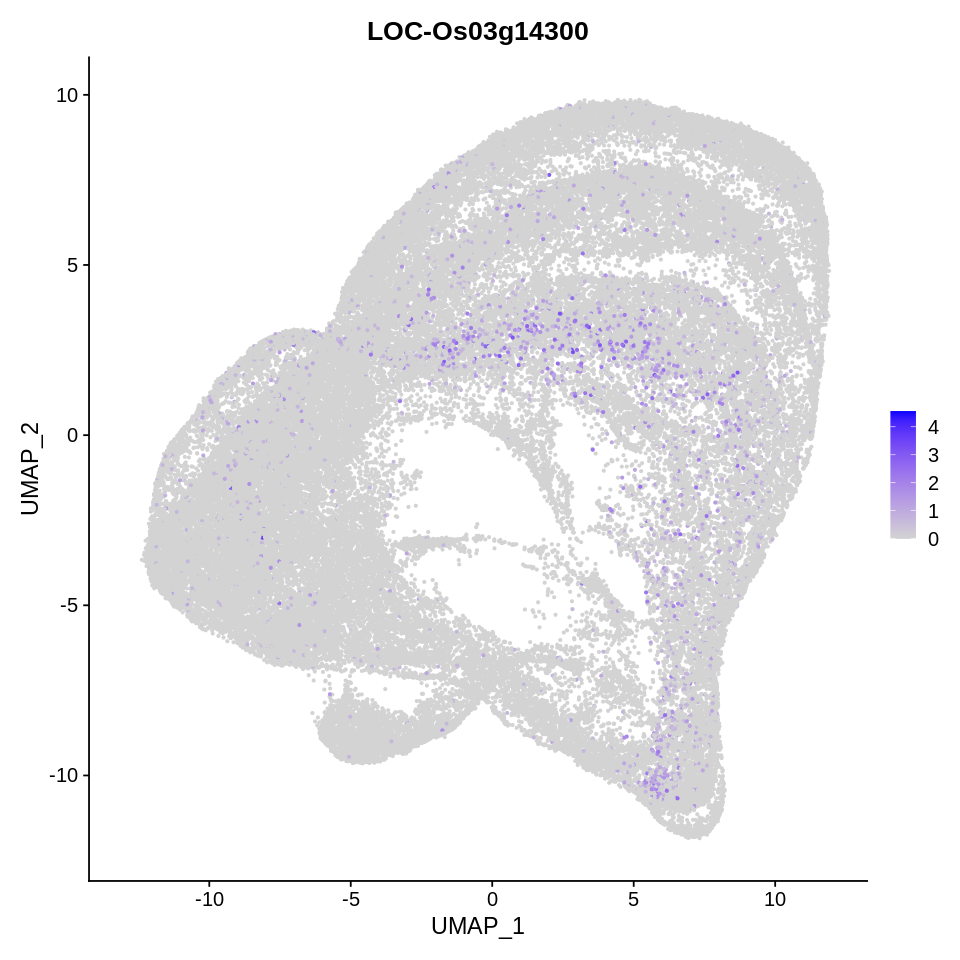

In [154]:
## Root Cap markers
print(FeaturePlot(rc.integrated, feature= "LOC-Os03g14300", pt.size=0.5))

## Save

In [338]:
saveRDS(rc.integrated, file = "./scRNA-seq/Integrated_Objects/Rice_8S_gel_soil_20231109_seu3.rds")